In [174]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
sns.set_theme(style="ticks", color_codes=True)
plt.rcParams["figure.figsize"] = (20,7)
from sklearn import model_selection, preprocessing, linear_model, naive_bayes, metrics, svm
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score, confusion_matrix, classification_report
from sklearn import preprocessing
import os

In [175]:
# le = preprocessing.LabelEncoder()

In [176]:
# import zipfile
# UNZIP_PATH = 'D:/PGDBA 2020-22/2Second_sem_IIT_Kgp/DSL/project/Group/App/'
# with zipfile.ZipFile(UNZIP_PATH + 'data.zip', 'r') as zip_ref:
#     zip_ref.extractall('D:/PGDBA 2020-22/2Second_sem_IIT_Kgp/DSL/project/Group/App/')

In [185]:
df1 = pd.read_csv('data.csv')

In [186]:
df1.head()

,PRODUCT,SUB_PRODUCT,ISSUE,COMPANY,STATE,SUBMITTED_VIA,COMPANY_RESPONSE_TO_CONSUMER,TIMELY_RESPONSE,CONSUMER_DISPUTED?,DATE_DIFF
0,Mortgage,Other mortgage,"Loan modification,collection,foreclosure",U.S. Bancorp,CA,Referral,Closed with explanation,Yes,Yes,4.0
1,Mortgage,Other mortgage,"Loan servicing, payments, escrow account",Wells Fargo & Company,CA,Referral,Closed with explanation,Yes,Yes,4.0
2,Student loan,Non-federal student loan,Repaying your loan,"Navient Solutions, Inc.",MD,Email,Closed with explanation,Yes,Yes,19.0
3,Debt collection,Credit card,False statements or representation,Resurgent Capital Services L.P.,GA,Web,Closed with explanation,Yes,Yes,0.0
4,Bank account or service,Checking account,Deposits and withdrawals,Bank of America,IL,Referral,Closed with explanation,Yes,No,0.0


In [187]:
# df1['PRODUCT'] = le.fit_transform(df1['PRODUCT'])

In [188]:
# le.classes_

In [189]:
# le.inverse_transform([0,1,2,3,4,5,6,7,8])

In [295]:
from sklearn.model_selection import StratifiedKFold
def cross(model):
    train_f1 = []
    test_f1 = []
    kf = StratifiedKFold(n_splits=3,random_state= 123, shuffle=True)
    for train_index, test_index in kf.split(X,y):
        cv_train, cv_test =X.iloc[train_index], X.iloc[test_index]
        y_train, y_test =y.iloc[train_index], y.iloc[test_index]

        model.fit(cv_train, y_train)
        train_acc = f1_score(y_train, model.predict(cv_train), average = 'macro')
        train_f1.append(train_acc)
        test_acc = f1_score(y_test, model.predict(cv_test), average = 'macro')
        test_f1.append(test_acc)
    return np.mean(train_f1), np.mean(test_f1)

In [190]:
t10c = df1['COMPANY'].value_counts()[0:100].index.to_list()

In [191]:
len(t10c)

100

In [192]:
df1['COMPANY'] = df1['COMPANY'].apply(lambda x: x if (x in t10c) else 'others')

In [265]:
df1.shape

(393951, 10)

In [207]:
data1 = df1[df1['TIMELY_RESPONSE'] == 'Yes']
data2 = df1[df1['TIMELY_RESPONSE'] == 'No']

In [208]:
data1.shape

(380750, 10)

In [209]:
data2.shape

(13201, 10)

In [283]:
shuffled = data1.sample(frac=1)
splits = 27
data1_split = np.array_split(shuffled, splits)

# Algorithm




Shape of data 0 is :
(27303, 10)
Distribution of 0 is :
Yes    14102
No     13201
Name: TIMELY_RESPONSE, dtype: int64


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 0 is : 0.8122067610378153
Train f1_score [No]: for data 0 is : 0.8188044109112013
              precision    recall  f1-score   support

          No       0.77      0.85      0.81       924
         Yes       0.85      0.76      0.80       988

    accuracy                           0.81      1912
   macro avg       0.81      0.81      0.81      1912
weighted avg       0.81      0.81      0.81      1912



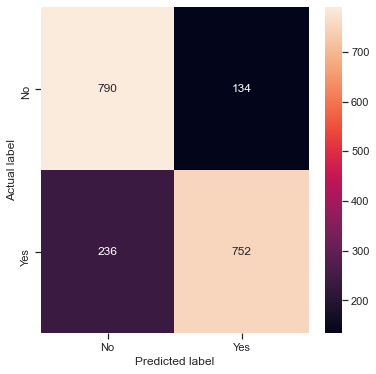

Cross validation result for data 0 is :
0:	learn: 0.6329810	total: 41.8ms	remaining: 8.32s
1:	learn: 0.5906892	total: 91.4ms	remaining: 9.05s
2:	learn: 0.5641798	total: 135ms	remaining: 8.86s
3:	learn: 0.5447405	total: 178ms	remaining: 8.7s
4:	learn: 0.5228521	total: 225ms	remaining: 8.76s
5:	learn: 0.5105343	total: 269ms	remaining: 8.7s
6:	learn: 0.5001678	total: 337ms	remaining: 9.29s
7:	learn: 0.4911784	total: 381ms	remaining: 9.14s
8:	learn: 0.4839942	total: 423ms	remaining: 8.97s
9:	learn: 0.4777957	total: 469ms	remaining: 8.91s
10:	learn: 0.4727227	total: 520ms	remaining: 8.94s
11:	learn: 0.4681999	total: 566ms	remaining: 8.87s
12:	learn: 0.4647968	total: 614ms	remaining: 8.83s
13:	learn: 0.4623233	total: 661ms	remaining: 8.79s
14:	learn: 0.4595783	total: 709ms	remaining: 8.75s
15:	learn: 0.4570794	total: 759ms	remaining: 8.72s
16:	learn: 0.4556544	total: 806ms	remaining: 8.68s
17:	learn: 0.4537090	total: 853ms	remaining: 8.62s
18:	learn: 0.4522688	total: 900ms	remaining: 8.57s
1

162:	learn: 0.4052796	total: 8.05s	remaining: 1.83s
163:	learn: 0.4052566	total: 8.09s	remaining: 1.77s
164:	learn: 0.4051237	total: 8.13s	remaining: 1.72s
165:	learn: 0.4049479	total: 8.18s	remaining: 1.67s
166:	learn: 0.4045905	total: 8.23s	remaining: 1.63s
167:	learn: 0.4044939	total: 8.28s	remaining: 1.58s
168:	learn: 0.4043700	total: 8.32s	remaining: 1.53s
169:	learn: 0.4042755	total: 8.38s	remaining: 1.48s
170:	learn: 0.4039198	total: 8.43s	remaining: 1.43s
171:	learn: 0.4036279	total: 8.48s	remaining: 1.38s
172:	learn: 0.4035356	total: 8.53s	remaining: 1.33s
173:	learn: 0.4033507	total: 8.58s	remaining: 1.28s
174:	learn: 0.4031820	total: 8.64s	remaining: 1.23s
175:	learn: 0.4030388	total: 8.7s	remaining: 1.19s
176:	learn: 0.4029092	total: 8.75s	remaining: 1.14s
177:	learn: 0.4027938	total: 8.82s	remaining: 1.09s
178:	learn: 0.4027028	total: 8.86s	remaining: 1.04s
179:	learn: 0.4025874	total: 8.93s	remaining: 992ms
180:	learn: 0.4025163	total: 8.98s	remaining: 943ms
181:	learn: 0

127:	learn: 0.4125115	total: 7.53s	remaining: 4.24s
128:	learn: 0.4119346	total: 7.6s	remaining: 4.18s
129:	learn: 0.4117225	total: 7.65s	remaining: 4.12s
130:	learn: 0.4115968	total: 7.69s	remaining: 4.05s
131:	learn: 0.4114816	total: 7.74s	remaining: 3.99s
132:	learn: 0.4113810	total: 7.79s	remaining: 3.92s
133:	learn: 0.4112332	total: 7.84s	remaining: 3.86s
134:	learn: 0.4111027	total: 7.87s	remaining: 3.79s
135:	learn: 0.4108570	total: 7.93s	remaining: 3.73s
136:	learn: 0.4107169	total: 7.97s	remaining: 3.67s
137:	learn: 0.4103017	total: 8.02s	remaining: 3.6s
138:	learn: 0.4102619	total: 8.07s	remaining: 3.54s
139:	learn: 0.4102412	total: 8.14s	remaining: 3.49s
140:	learn: 0.4100945	total: 8.18s	remaining: 3.42s
141:	learn: 0.4100146	total: 8.23s	remaining: 3.36s
142:	learn: 0.4099166	total: 8.27s	remaining: 3.3s
143:	learn: 0.4098560	total: 8.31s	remaining: 3.23s
144:	learn: 0.4097072	total: 8.36s	remaining: 3.17s
145:	learn: 0.4096359	total: 8.4s	remaining: 3.11s
146:	learn: 0.40

91:	learn: 0.4198815	total: 4.47s	remaining: 5.25s
92:	learn: 0.4196610	total: 4.52s	remaining: 5.2s
93:	learn: 0.4194906	total: 4.57s	remaining: 5.15s
94:	learn: 0.4193305	total: 4.61s	remaining: 5.1s
95:	learn: 0.4192582	total: 4.66s	remaining: 5.04s
96:	learn: 0.4188563	total: 4.7s	remaining: 4.99s
97:	learn: 0.4187813	total: 4.76s	remaining: 4.96s
98:	learn: 0.4180572	total: 4.81s	remaining: 4.91s
99:	learn: 0.4175373	total: 4.88s	remaining: 4.88s
100:	learn: 0.4169910	total: 4.93s	remaining: 4.83s
101:	learn: 0.4165630	total: 4.98s	remaining: 4.78s
102:	learn: 0.4164483	total: 5.04s	remaining: 4.74s
103:	learn: 0.4161748	total: 5.08s	remaining: 4.69s
104:	learn: 0.4158439	total: 5.14s	remaining: 4.65s
105:	learn: 0.4152810	total: 5.19s	remaining: 4.6s
106:	learn: 0.4151225	total: 5.23s	remaining: 4.55s
107:	learn: 0.4151219	total: 5.26s	remaining: 4.48s
108:	learn: 0.4144551	total: 5.32s	remaining: 4.44s
109:	learn: 0.4143456	total: 5.36s	remaining: 4.38s
110:	learn: 0.4139271	tot

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 1 is : 0.8141105029763094
Train f1_score [No]: for data 1 is : 0.8193079880392995
              precision    recall  f1-score   support

          No       0.79      0.84      0.82       924
         Yes       0.84      0.79      0.82       988

    accuracy                           0.82      1912
   macro avg       0.82      0.82      0.82      1912
weighted avg       0.82      0.82      0.82      1912



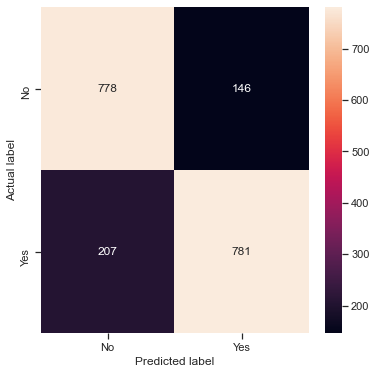

Cross validation result for data 1 is :
0:	learn: 0.6331875	total: 42.5ms	remaining: 8.45s
1:	learn: 0.5984837	total: 88.8ms	remaining: 8.79s
2:	learn: 0.5723261	total: 128ms	remaining: 8.39s
3:	learn: 0.5467172	total: 173ms	remaining: 8.49s
4:	learn: 0.5279347	total: 226ms	remaining: 8.8s
5:	learn: 0.5135094	total: 274ms	remaining: 8.86s
6:	learn: 0.5029832	total: 326ms	remaining: 8.99s
7:	learn: 0.4950805	total: 371ms	remaining: 8.89s
8:	learn: 0.4865319	total: 416ms	remaining: 8.83s
9:	learn: 0.4780437	total: 463ms	remaining: 8.8s
10:	learn: 0.4717649	total: 507ms	remaining: 8.72s
11:	learn: 0.4677821	total: 552ms	remaining: 8.65s
12:	learn: 0.4623575	total: 594ms	remaining: 8.54s
13:	learn: 0.4605146	total: 632ms	remaining: 8.4s
14:	learn: 0.4571766	total: 674ms	remaining: 8.32s
15:	learn: 0.4551059	total: 725ms	remaining: 8.33s
16:	learn: 0.4529403	total: 764ms	remaining: 8.23s
17:	learn: 0.4514616	total: 807ms	remaining: 8.15s
18:	learn: 0.4496887	total: 849ms	remaining: 8.09s
19

163:	learn: 0.4032876	total: 8.45s	remaining: 1.85s
164:	learn: 0.4031873	total: 8.5s	remaining: 1.8s
165:	learn: 0.4029644	total: 8.55s	remaining: 1.75s
166:	learn: 0.4027140	total: 8.61s	remaining: 1.7s
167:	learn: 0.4026034	total: 8.66s	remaining: 1.65s
168:	learn: 0.4022240	total: 8.71s	remaining: 1.6s
169:	learn: 0.4021990	total: 8.77s	remaining: 1.55s
170:	learn: 0.4020527	total: 8.82s	remaining: 1.5s
171:	learn: 0.4018602	total: 8.87s	remaining: 1.44s
172:	learn: 0.4018390	total: 8.94s	remaining: 1.4s
173:	learn: 0.4016841	total: 9.01s	remaining: 1.34s
174:	learn: 0.4014361	total: 9.11s	remaining: 1.3s
175:	learn: 0.4011964	total: 9.18s	remaining: 1.25s
176:	learn: 0.4010278	total: 9.26s	remaining: 1.2s
177:	learn: 0.4007332	total: 9.4s	remaining: 1.16s
178:	learn: 0.4005347	total: 9.49s	remaining: 1.11s
179:	learn: 0.4004299	total: 9.57s	remaining: 1.06s
180:	learn: 0.4002721	total: 9.66s	remaining: 1.01s
181:	learn: 0.4001327	total: 9.76s	remaining: 966ms
182:	learn: 0.4000503

127:	learn: 0.4088631	total: 6.21s	remaining: 3.49s
128:	learn: 0.4083463	total: 6.26s	remaining: 3.44s
129:	learn: 0.4079616	total: 6.31s	remaining: 3.4s
130:	learn: 0.4078469	total: 6.36s	remaining: 3.35s
131:	learn: 0.4077775	total: 6.41s	remaining: 3.3s
132:	learn: 0.4075971	total: 6.46s	remaining: 3.25s
133:	learn: 0.4073641	total: 6.51s	remaining: 3.21s
134:	learn: 0.4070060	total: 6.56s	remaining: 3.16s
135:	learn: 0.4069973	total: 6.6s	remaining: 3.11s
136:	learn: 0.4065109	total: 6.65s	remaining: 3.06s
137:	learn: 0.4064519	total: 6.7s	remaining: 3.01s
138:	learn: 0.4062626	total: 6.75s	remaining: 2.96s
139:	learn: 0.4060682	total: 6.8s	remaining: 2.91s
140:	learn: 0.4059814	total: 6.84s	remaining: 2.86s
141:	learn: 0.4059558	total: 6.89s	remaining: 2.81s
142:	learn: 0.4058043	total: 6.93s	remaining: 2.76s
143:	learn: 0.4052414	total: 6.98s	remaining: 2.71s
144:	learn: 0.4051426	total: 7.03s	remaining: 2.67s
145:	learn: 0.4048790	total: 7.08s	remaining: 2.62s
146:	learn: 0.404

90:	learn: 0.4195116	total: 4.24s	remaining: 5.08s
91:	learn: 0.4192809	total: 4.29s	remaining: 5.03s
92:	learn: 0.4191635	total: 4.33s	remaining: 4.98s
93:	learn: 0.4187231	total: 4.38s	remaining: 4.94s
94:	learn: 0.4182689	total: 4.43s	remaining: 4.89s
95:	learn: 0.4180369	total: 4.48s	remaining: 4.86s
96:	learn: 0.4178647	total: 4.54s	remaining: 4.82s
97:	learn: 0.4176549	total: 4.58s	remaining: 4.77s
98:	learn: 0.4174890	total: 4.63s	remaining: 4.73s
99:	learn: 0.4174838	total: 4.66s	remaining: 4.66s
100:	learn: 0.4171674	total: 4.71s	remaining: 4.62s
101:	learn: 0.4166770	total: 4.76s	remaining: 4.57s
102:	learn: 0.4159435	total: 4.81s	remaining: 4.53s
103:	learn: 0.4158140	total: 4.87s	remaining: 4.5s
104:	learn: 0.4156791	total: 4.94s	remaining: 4.47s
105:	learn: 0.4156626	total: 4.99s	remaining: 4.43s
106:	learn: 0.4155395	total: 5.04s	remaining: 4.38s
107:	learn: 0.4154040	total: 5.08s	remaining: 4.33s
108:	learn: 0.4150284	total: 5.14s	remaining: 4.29s
109:	learn: 0.4147099	t

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 2 is : 0.8168075229139389
Train f1_score [No]: for data 2 is : 0.8195003713984127
              precision    recall  f1-score   support

          No       0.78      0.86      0.82       924
         Yes       0.85      0.78      0.81       988

    accuracy                           0.82      1912
   macro avg       0.82      0.82      0.82      1912
weighted avg       0.82      0.82      0.82      1912



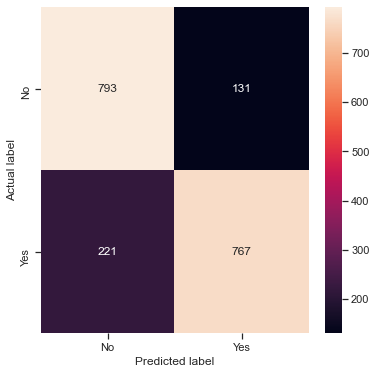

Cross validation result for data 2 is :
0:	learn: 0.6455315	total: 43.3ms	remaining: 8.61s
1:	learn: 0.5975437	total: 90.5ms	remaining: 8.96s
2:	learn: 0.5696486	total: 136ms	remaining: 8.93s
3:	learn: 0.5479973	total: 192ms	remaining: 9.4s
4:	learn: 0.5304259	total: 233ms	remaining: 9.08s
5:	learn: 0.5117665	total: 295ms	remaining: 9.54s
6:	learn: 0.5007855	total: 401ms	remaining: 11.1s
7:	learn: 0.4919359	total: 446ms	remaining: 10.7s
8:	learn: 0.4843130	total: 574ms	remaining: 12.2s
9:	learn: 0.4783184	total: 663ms	remaining: 12.6s
10:	learn: 0.4728186	total: 731ms	remaining: 12.6s
11:	learn: 0.4663439	total: 793ms	remaining: 12.4s
12:	learn: 0.4628618	total: 873ms	remaining: 12.6s
13:	learn: 0.4586512	total: 937ms	remaining: 12.4s
14:	learn: 0.4561272	total: 984ms	remaining: 12.1s
15:	learn: 0.4544056	total: 1.07s	remaining: 12.3s
16:	learn: 0.4524421	total: 1.14s	remaining: 12.2s
17:	learn: 0.4509334	total: 1.18s	remaining: 12s
18:	learn: 0.4490441	total: 1.25s	remaining: 11.9s
19

161:	learn: 0.4035904	total: 9.62s	remaining: 2.26s
162:	learn: 0.4035087	total: 9.68s	remaining: 2.2s
163:	learn: 0.4034833	total: 9.74s	remaining: 2.14s
164:	learn: 0.4032795	total: 9.81s	remaining: 2.08s
165:	learn: 0.4030375	total: 9.87s	remaining: 2.02s
166:	learn: 0.4027225	total: 9.92s	remaining: 1.96s
167:	learn: 0.4026406	total: 9.98s	remaining: 1.9s
168:	learn: 0.4022948	total: 10s	remaining: 1.84s
169:	learn: 0.4019862	total: 10.1s	remaining: 1.78s
170:	learn: 0.4018058	total: 10.2s	remaining: 1.72s
171:	learn: 0.4017053	total: 10.2s	remaining: 1.66s
172:	learn: 0.4015815	total: 10.3s	remaining: 1.6s
173:	learn: 0.4015735	total: 10.3s	remaining: 1.54s
174:	learn: 0.4012376	total: 10.4s	remaining: 1.48s
175:	learn: 0.4011941	total: 10.4s	remaining: 1.42s
176:	learn: 0.4011654	total: 10.5s	remaining: 1.36s
177:	learn: 0.4010434	total: 10.5s	remaining: 1.3s
178:	learn: 0.4009334	total: 10.6s	remaining: 1.24s
179:	learn: 0.4006510	total: 10.7s	remaining: 1.18s
180:	learn: 0.4005

123:	learn: 0.4111449	total: 6.52s	remaining: 4s
124:	learn: 0.4109815	total: 6.57s	remaining: 3.94s
125:	learn: 0.4106749	total: 6.63s	remaining: 3.9s
126:	learn: 0.4104161	total: 6.68s	remaining: 3.84s
127:	learn: 0.4098584	total: 6.74s	remaining: 3.79s
128:	learn: 0.4095971	total: 6.8s	remaining: 3.75s
129:	learn: 0.4095017	total: 6.86s	remaining: 3.7s
130:	learn: 0.4092664	total: 6.92s	remaining: 3.64s
131:	learn: 0.4089709	total: 6.97s	remaining: 3.59s
132:	learn: 0.4089472	total: 7.02s	remaining: 3.54s
133:	learn: 0.4087148	total: 7.06s	remaining: 3.48s
134:	learn: 0.4085782	total: 7.11s	remaining: 3.42s
135:	learn: 0.4084792	total: 7.16s	remaining: 3.37s
136:	learn: 0.4084165	total: 7.21s	remaining: 3.31s
137:	learn: 0.4082531	total: 7.25s	remaining: 3.26s
138:	learn: 0.4080763	total: 7.29s	remaining: 3.2s
139:	learn: 0.4077739	total: 7.35s	remaining: 3.15s
140:	learn: 0.4075363	total: 7.39s	remaining: 3.09s
141:	learn: 0.4074625	total: 7.45s	remaining: 3.04s
142:	learn: 0.40724

84:	learn: 0.4195825	total: 4.78s	remaining: 6.46s
85:	learn: 0.4193727	total: 4.82s	remaining: 6.39s
86:	learn: 0.4190565	total: 4.86s	remaining: 6.32s
87:	learn: 0.4184905	total: 4.91s	remaining: 6.25s
88:	learn: 0.4183668	total: 4.97s	remaining: 6.2s
89:	learn: 0.4179639	total: 5.03s	remaining: 6.14s
90:	learn: 0.4178938	total: 5.07s	remaining: 6.08s
91:	learn: 0.4177715	total: 5.12s	remaining: 6.01s
92:	learn: 0.4175451	total: 5.17s	remaining: 5.95s
93:	learn: 0.4169359	total: 5.22s	remaining: 5.88s
94:	learn: 0.4166659	total: 5.28s	remaining: 5.83s
95:	learn: 0.4162458	total: 5.33s	remaining: 5.77s
96:	learn: 0.4160528	total: 5.39s	remaining: 5.72s
97:	learn: 0.4158605	total: 5.45s	remaining: 5.67s
98:	learn: 0.4154470	total: 5.5s	remaining: 5.61s
99:	learn: 0.4152657	total: 5.54s	remaining: 5.54s
100:	learn: 0.4151733	total: 5.59s	remaining: 5.48s
101:	learn: 0.4150745	total: 5.64s	remaining: 5.42s
102:	learn: 0.4148710	total: 5.68s	remaining: 5.35s
103:	learn: 0.4142679	total: 5

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 3 is : 0.8133381660021748
Train f1_score [No]: for data 3 is : 0.8213941659280954
              precision    recall  f1-score   support

          No       0.78      0.86      0.81       924
         Yes       0.85      0.77      0.81       988

    accuracy                           0.81      1912
   macro avg       0.81      0.81      0.81      1912
weighted avg       0.81      0.81      0.81      1912



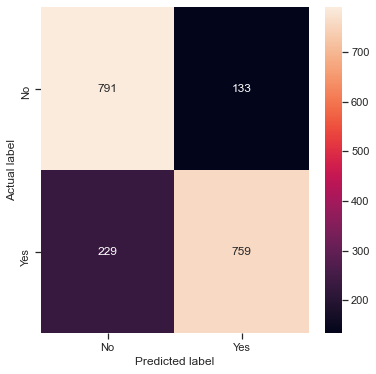

Cross validation result for data 3 is :
0:	learn: 0.6349340	total: 51.4ms	remaining: 10.2s
1:	learn: 0.5889256	total: 93.2ms	remaining: 9.23s
2:	learn: 0.5578632	total: 142ms	remaining: 9.31s
3:	learn: 0.5386961	total: 187ms	remaining: 9.15s
4:	learn: 0.5210657	total: 233ms	remaining: 9.09s
5:	learn: 0.5079195	total: 283ms	remaining: 9.14s
6:	learn: 0.4970775	total: 326ms	remaining: 9s
7:	learn: 0.4893117	total: 380ms	remaining: 9.11s
8:	learn: 0.4827154	total: 439ms	remaining: 9.31s
9:	learn: 0.4758882	total: 492ms	remaining: 9.35s
10:	learn: 0.4694553	total: 548ms	remaining: 9.41s
11:	learn: 0.4658166	total: 609ms	remaining: 9.54s
12:	learn: 0.4621717	total: 658ms	remaining: 9.47s
13:	learn: 0.4580309	total: 708ms	remaining: 9.41s
14:	learn: 0.4552852	total: 772ms	remaining: 9.53s
15:	learn: 0.4530481	total: 833ms	remaining: 9.59s
16:	learn: 0.4506918	total: 903ms	remaining: 9.72s
17:	learn: 0.4485930	total: 960ms	remaining: 9.71s
18:	learn: 0.4472976	total: 1s	remaining: 9.56s
19:	l

162:	learn: 0.4028989	total: 8.72s	remaining: 1.98s
163:	learn: 0.4025592	total: 8.77s	remaining: 1.92s
164:	learn: 0.4023846	total: 8.81s	remaining: 1.87s
165:	learn: 0.4023313	total: 8.85s	remaining: 1.81s
166:	learn: 0.4022091	total: 8.9s	remaining: 1.76s
167:	learn: 0.4018639	total: 8.95s	remaining: 1.71s
168:	learn: 0.4016260	total: 9.02s	remaining: 1.65s
169:	learn: 0.4014690	total: 9.1s	remaining: 1.61s
170:	learn: 0.4013363	total: 9.16s	remaining: 1.55s
171:	learn: 0.4011278	total: 9.23s	remaining: 1.5s
172:	learn: 0.4009866	total: 9.28s	remaining: 1.45s
173:	learn: 0.4007973	total: 9.33s	remaining: 1.39s
174:	learn: 0.4007046	total: 9.38s	remaining: 1.34s
175:	learn: 0.4004525	total: 9.44s	remaining: 1.29s
176:	learn: 0.4002949	total: 9.48s	remaining: 1.23s
177:	learn: 0.4000382	total: 9.57s	remaining: 1.18s
178:	learn: 0.3998086	total: 9.62s	remaining: 1.13s
179:	learn: 0.3995880	total: 9.66s	remaining: 1.07s
180:	learn: 0.3995249	total: 9.71s	remaining: 1.02s
181:	learn: 0.3

124:	learn: 0.4062784	total: 6.98s	remaining: 4.19s
125:	learn: 0.4060202	total: 7.03s	remaining: 4.13s
126:	learn: 0.4059933	total: 7.08s	remaining: 4.07s
127:	learn: 0.4057976	total: 7.15s	remaining: 4.02s
128:	learn: 0.4054735	total: 7.22s	remaining: 3.97s
129:	learn: 0.4054610	total: 7.27s	remaining: 3.91s
130:	learn: 0.4051724	total: 7.31s	remaining: 3.85s
131:	learn: 0.4049450	total: 7.36s	remaining: 3.79s
132:	learn: 0.4044560	total: 7.41s	remaining: 3.73s
133:	learn: 0.4044429	total: 7.45s	remaining: 3.67s
134:	learn: 0.4043400	total: 7.5s	remaining: 3.61s
135:	learn: 0.4041221	total: 7.55s	remaining: 3.55s
136:	learn: 0.4039543	total: 7.59s	remaining: 3.49s
137:	learn: 0.4037357	total: 7.67s	remaining: 3.44s
138:	learn: 0.4036546	total: 7.72s	remaining: 3.39s
139:	learn: 0.4035322	total: 7.76s	remaining: 3.33s
140:	learn: 0.4031478	total: 7.82s	remaining: 3.27s
141:	learn: 0.4028064	total: 7.89s	remaining: 3.22s
142:	learn: 0.4026251	total: 7.93s	remaining: 3.16s
143:	learn: 0

87:	learn: 0.4217294	total: 4.78s	remaining: 6.08s
88:	learn: 0.4216320	total: 4.83s	remaining: 6.03s
89:	learn: 0.4215089	total: 4.91s	remaining: 6s
90:	learn: 0.4213339	total: 4.97s	remaining: 5.96s
91:	learn: 0.4211728	total: 5.04s	remaining: 5.91s
92:	learn: 0.4209662	total: 5.09s	remaining: 5.86s
93:	learn: 0.4204427	total: 5.16s	remaining: 5.82s
94:	learn: 0.4203222	total: 5.21s	remaining: 5.76s
95:	learn: 0.4202048	total: 5.27s	remaining: 5.71s
96:	learn: 0.4200360	total: 5.32s	remaining: 5.65s
97:	learn: 0.4199669	total: 5.37s	remaining: 5.59s
98:	learn: 0.4194623	total: 5.42s	remaining: 5.53s
99:	learn: 0.4193188	total: 5.47s	remaining: 5.47s
100:	learn: 0.4189912	total: 5.55s	remaining: 5.44s
101:	learn: 0.4184542	total: 5.61s	remaining: 5.39s
102:	learn: 0.4181746	total: 5.68s	remaining: 5.35s
103:	learn: 0.4176445	total: 5.74s	remaining: 5.3s
104:	learn: 0.4170178	total: 5.79s	remaining: 5.24s
105:	learn: 0.4168351	total: 5.85s	remaining: 5.19s
106:	learn: 0.4165894	total: 

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 4 is : 0.8125200384738699
Train f1_score [No]: for data 4 is : 0.818892760356175
              precision    recall  f1-score   support

          No       0.77      0.86      0.81       924
         Yes       0.85      0.76      0.80       988

    accuracy                           0.81      1912
   macro avg       0.81      0.81      0.81      1912
weighted avg       0.81      0.81      0.81      1912



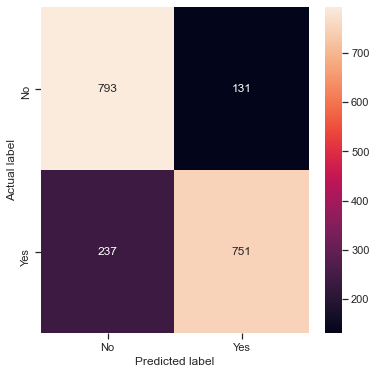

Cross validation result for data 4 is :
0:	learn: 0.6356139	total: 46.9ms	remaining: 9.34s
1:	learn: 0.5916431	total: 91.4ms	remaining: 9.05s
2:	learn: 0.5670811	total: 136ms	remaining: 8.95s
3:	learn: 0.5451739	total: 180ms	remaining: 8.8s
4:	learn: 0.5268373	total: 234ms	remaining: 9.14s
5:	learn: 0.5144146	total: 292ms	remaining: 9.43s
6:	learn: 0.5034046	total: 340ms	remaining: 9.37s
7:	learn: 0.4947482	total: 405ms	remaining: 9.73s
8:	learn: 0.4865873	total: 508ms	remaining: 10.8s
9:	learn: 0.4795191	total: 573ms	remaining: 10.9s
10:	learn: 0.4746253	total: 649ms	remaining: 11.2s
11:	learn: 0.4699435	total: 714ms	remaining: 11.2s
12:	learn: 0.4663244	total: 758ms	remaining: 10.9s
13:	learn: 0.4643010	total: 791ms	remaining: 10.5s
14:	learn: 0.4615140	total: 837ms	remaining: 10.3s
15:	learn: 0.4596991	total: 890ms	remaining: 10.2s
16:	learn: 0.4583364	total: 941ms	remaining: 10.1s
17:	learn: 0.4559381	total: 1.01s	remaining: 10.2s
18:	learn: 0.4538298	total: 1.06s	remaining: 10.1s


160:	learn: 0.4051665	total: 8.72s	remaining: 2.11s
161:	learn: 0.4049551	total: 8.79s	remaining: 2.06s
162:	learn: 0.4047083	total: 8.85s	remaining: 2.01s
163:	learn: 0.4042081	total: 8.89s	remaining: 1.95s
164:	learn: 0.4041506	total: 8.94s	remaining: 1.9s
165:	learn: 0.4041013	total: 8.98s	remaining: 1.84s
166:	learn: 0.4039571	total: 9.03s	remaining: 1.78s
167:	learn: 0.4039455	total: 9.09s	remaining: 1.73s
168:	learn: 0.4036950	total: 9.14s	remaining: 1.68s
169:	learn: 0.4035463	total: 9.2s	remaining: 1.62s
170:	learn: 0.4034378	total: 9.25s	remaining: 1.57s
171:	learn: 0.4032971	total: 9.29s	remaining: 1.51s
172:	learn: 0.4032304	total: 9.35s	remaining: 1.46s
173:	learn: 0.4030822	total: 9.4s	remaining: 1.4s
174:	learn: 0.4029582	total: 9.45s	remaining: 1.35s
175:	learn: 0.4027742	total: 9.49s	remaining: 1.29s
176:	learn: 0.4025888	total: 9.53s	remaining: 1.24s
177:	learn: 0.4023454	total: 9.58s	remaining: 1.18s
178:	learn: 0.4021970	total: 9.63s	remaining: 1.13s
179:	learn: 0.40

122:	learn: 0.4139014	total: 8.21s	remaining: 5.14s
123:	learn: 0.4133545	total: 8.26s	remaining: 5.06s
124:	learn: 0.4128511	total: 8.32s	remaining: 4.99s
125:	learn: 0.4124027	total: 8.38s	remaining: 4.92s
126:	learn: 0.4118713	total: 8.44s	remaining: 4.85s
127:	learn: 0.4114381	total: 8.49s	remaining: 4.77s
128:	learn: 0.4110701	total: 8.54s	remaining: 4.7s
129:	learn: 0.4107702	total: 8.6s	remaining: 4.63s
130:	learn: 0.4107219	total: 8.65s	remaining: 4.56s
131:	learn: 0.4105527	total: 8.71s	remaining: 4.49s
132:	learn: 0.4101906	total: 8.75s	remaining: 4.41s
133:	learn: 0.4098537	total: 8.84s	remaining: 4.35s
134:	learn: 0.4093844	total: 8.9s	remaining: 4.29s
135:	learn: 0.4092041	total: 8.95s	remaining: 4.21s
136:	learn: 0.4089131	total: 9.01s	remaining: 4.14s
137:	learn: 0.4084660	total: 9.07s	remaining: 4.08s
138:	learn: 0.4083822	total: 9.13s	remaining: 4s
139:	learn: 0.4082690	total: 9.18s	remaining: 3.94s
140:	learn: 0.4082225	total: 9.24s	remaining: 3.87s
141:	learn: 0.4080

87:	learn: 0.4197728	total: 5.74s	remaining: 7.31s
88:	learn: 0.4194011	total: 5.8s	remaining: 7.23s
89:	learn: 0.4189976	total: 5.85s	remaining: 7.16s
90:	learn: 0.4189976	total: 5.87s	remaining: 7.04s
91:	learn: 0.4188337	total: 5.93s	remaining: 6.96s
92:	learn: 0.4188054	total: 5.98s	remaining: 6.88s
93:	learn: 0.4186859	total: 6.03s	remaining: 6.8s
94:	learn: 0.4181370	total: 6.09s	remaining: 6.73s
95:	learn: 0.4180533	total: 6.14s	remaining: 6.65s
96:	learn: 0.4179578	total: 6.19s	remaining: 6.57s
97:	learn: 0.4179240	total: 6.24s	remaining: 6.49s
98:	learn: 0.4177270	total: 6.28s	remaining: 6.41s
99:	learn: 0.4169255	total: 6.34s	remaining: 6.34s
100:	learn: 0.4165028	total: 6.39s	remaining: 6.27s
101:	learn: 0.4163212	total: 6.46s	remaining: 6.2s
102:	learn: 0.4160602	total: 6.53s	remaining: 6.15s
103:	learn: 0.4156316	total: 6.59s	remaining: 6.08s
104:	learn: 0.4154610	total: 6.65s	remaining: 6.01s
105:	learn: 0.4149976	total: 6.71s	remaining: 5.96s
106:	learn: 0.4147632	total:

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 5 is : 0.8173698062046415
Train f1_score [No]: for data 5 is : 0.821817615935263
              precision    recall  f1-score   support

          No       0.79      0.85      0.82       924
         Yes       0.85      0.79      0.82       988

    accuracy                           0.82      1912
   macro avg       0.82      0.82      0.82      1912
weighted avg       0.82      0.82      0.82      1912



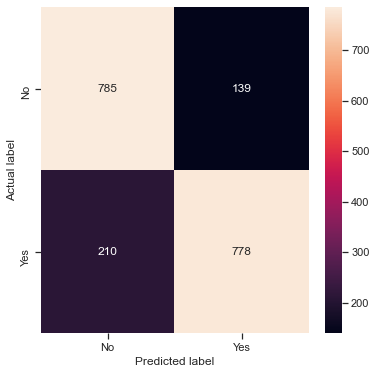

Cross validation result for data 5 is :
0:	learn: 0.6409732	total: 42.1ms	remaining: 8.37s
1:	learn: 0.5955957	total: 99ms	remaining: 9.8s
2:	learn: 0.5615305	total: 145ms	remaining: 9.54s
3:	learn: 0.5395843	total: 197ms	remaining: 9.63s
4:	learn: 0.5248248	total: 256ms	remaining: 9.98s
5:	learn: 0.5123119	total: 298ms	remaining: 9.63s
6:	learn: 0.5018096	total: 355ms	remaining: 9.79s
7:	learn: 0.4935467	total: 417ms	remaining: 10s
8:	learn: 0.4871809	total: 467ms	remaining: 9.9s
9:	learn: 0.4798610	total: 511ms	remaining: 9.7s
10:	learn: 0.4751416	total: 559ms	remaining: 9.6s
11:	learn: 0.4705750	total: 602ms	remaining: 9.43s
12:	learn: 0.4675809	total: 656ms	remaining: 9.44s
13:	learn: 0.4642990	total: 725ms	remaining: 9.64s
14:	learn: 0.4618855	total: 786ms	remaining: 9.69s
15:	learn: 0.4598704	total: 839ms	remaining: 9.65s
16:	learn: 0.4586259	total: 915ms	remaining: 9.85s
17:	learn: 0.4568531	total: 967ms	remaining: 9.78s
18:	learn: 0.4550743	total: 1.01s	remaining: 9.64s
19:	lea

161:	learn: 0.4082367	total: 9.59s	remaining: 2.25s
162:	learn: 0.4082235	total: 9.65s	remaining: 2.19s
163:	learn: 0.4080642	total: 9.71s	remaining: 2.13s
164:	learn: 0.4078983	total: 9.77s	remaining: 2.07s
165:	learn: 0.4075900	total: 9.84s	remaining: 2.01s
166:	learn: 0.4072598	total: 9.9s	remaining: 1.96s
167:	learn: 0.4070744	total: 9.95s	remaining: 1.9s
168:	learn: 0.4069003	total: 10s	remaining: 1.83s
169:	learn: 0.4067063	total: 10.1s	remaining: 1.78s
170:	learn: 0.4066208	total: 10.1s	remaining: 1.72s
171:	learn: 0.4064838	total: 10.2s	remaining: 1.66s
172:	learn: 0.4063303	total: 10.2s	remaining: 1.6s
173:	learn: 0.4062932	total: 10.3s	remaining: 1.53s
174:	learn: 0.4058241	total: 10.3s	remaining: 1.48s
175:	learn: 0.4055929	total: 10.4s	remaining: 1.42s
176:	learn: 0.4053821	total: 10.4s	remaining: 1.36s
177:	learn: 0.4052118	total: 10.5s	remaining: 1.3s
178:	learn: 0.4051571	total: 10.6s	remaining: 1.24s
179:	learn: 0.4051119	total: 10.6s	remaining: 1.18s
180:	learn: 0.4048

123:	learn: 0.4090645	total: 7.43s	remaining: 4.55s
124:	learn: 0.4087928	total: 7.49s	remaining: 4.49s
125:	learn: 0.4084994	total: 7.54s	remaining: 4.43s
126:	learn: 0.4084425	total: 7.61s	remaining: 4.38s
127:	learn: 0.4081190	total: 7.66s	remaining: 4.31s
128:	learn: 0.4080674	total: 7.72s	remaining: 4.25s
129:	learn: 0.4076682	total: 7.79s	remaining: 4.19s
130:	learn: 0.4073554	total: 7.85s	remaining: 4.14s
131:	learn: 0.4067820	total: 7.93s	remaining: 4.08s
132:	learn: 0.4066654	total: 7.97s	remaining: 4.02s
133:	learn: 0.4065972	total: 8.07s	remaining: 3.97s
134:	learn: 0.4063792	total: 8.15s	remaining: 3.92s
135:	learn: 0.4061834	total: 8.19s	remaining: 3.85s
136:	learn: 0.4058673	total: 8.24s	remaining: 3.79s
137:	learn: 0.4056145	total: 8.3s	remaining: 3.73s
138:	learn: 0.4054261	total: 8.35s	remaining: 3.66s
139:	learn: 0.4053471	total: 8.41s	remaining: 3.6s
140:	learn: 0.4052469	total: 8.45s	remaining: 3.54s
141:	learn: 0.4050985	total: 8.5s	remaining: 3.47s
142:	learn: 0.4

87:	learn: 0.4238292	total: 4.93s	remaining: 6.28s
88:	learn: 0.4230070	total: 4.98s	remaining: 6.21s
89:	learn: 0.4224535	total: 5.05s	remaining: 6.17s
90:	learn: 0.4221486	total: 5.1s	remaining: 6.11s
91:	learn: 0.4220328	total: 5.15s	remaining: 6.05s
92:	learn: 0.4216435	total: 5.2s	remaining: 5.99s
93:	learn: 0.4214832	total: 5.27s	remaining: 5.94s
94:	learn: 0.4213031	total: 5.34s	remaining: 5.91s
95:	learn: 0.4207682	total: 5.4s	remaining: 5.85s
96:	learn: 0.4200604	total: 5.45s	remaining: 5.79s
97:	learn: 0.4199456	total: 5.51s	remaining: 5.74s
98:	learn: 0.4197949	total: 5.61s	remaining: 5.73s
99:	learn: 0.4196377	total: 5.67s	remaining: 5.67s
100:	learn: 0.4196371	total: 5.71s	remaining: 5.6s
101:	learn: 0.4195724	total: 5.76s	remaining: 5.53s
102:	learn: 0.4193821	total: 5.81s	remaining: 5.48s
103:	learn: 0.4189793	total: 5.87s	remaining: 5.42s
104:	learn: 0.4189788	total: 5.91s	remaining: 5.34s
105:	learn: 0.4187444	total: 5.97s	remaining: 5.29s
106:	learn: 0.4184317	total: 

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 6 is : 0.8116233270366947
Train f1_score [No]: for data 6 is : 0.819041735840315
              precision    recall  f1-score   support

          No       0.77      0.86      0.81       924
         Yes       0.85      0.77      0.81       988

    accuracy                           0.81      1912
   macro avg       0.81      0.81      0.81      1912
weighted avg       0.82      0.81      0.81      1912



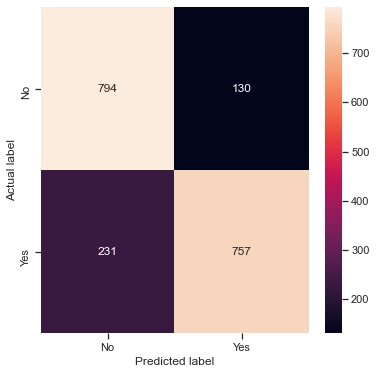

Cross validation result for data 6 is :
0:	learn: 0.6353847	total: 54.9ms	remaining: 10.9s
1:	learn: 0.5985333	total: 117ms	remaining: 11.6s
2:	learn: 0.5659092	total: 175ms	remaining: 11.5s
3:	learn: 0.5437285	total: 227ms	remaining: 11.1s
4:	learn: 0.5264725	total: 294ms	remaining: 11.4s
5:	learn: 0.5133450	total: 361ms	remaining: 11.7s
6:	learn: 0.4975148	total: 432ms	remaining: 11.9s
7:	learn: 0.4886355	total: 476ms	remaining: 11.4s
8:	learn: 0.4799142	total: 526ms	remaining: 11.2s
9:	learn: 0.4736644	total: 598ms	remaining: 11.4s
10:	learn: 0.4688724	total: 651ms	remaining: 11.2s
11:	learn: 0.4629778	total: 700ms	remaining: 11s
12:	learn: 0.4592002	total: 750ms	remaining: 10.8s
13:	learn: 0.4568139	total: 804ms	remaining: 10.7s
14:	learn: 0.4541402	total: 863ms	remaining: 10.6s
15:	learn: 0.4515045	total: 919ms	remaining: 10.6s
16:	learn: 0.4502274	total: 1.01s	remaining: 10.9s
17:	learn: 0.4488142	total: 1.06s	remaining: 10.8s
18:	learn: 0.4471996	total: 1.11s	remaining: 10.6s
19

162:	learn: 0.4018898	total: 11.5s	remaining: 2.62s
163:	learn: 0.4018622	total: 11.6s	remaining: 2.54s
164:	learn: 0.4016028	total: 11.7s	remaining: 2.47s
165:	learn: 0.4013525	total: 11.7s	remaining: 2.4s
166:	learn: 0.4012357	total: 11.8s	remaining: 2.33s
167:	learn: 0.4010434	total: 11.8s	remaining: 2.26s
168:	learn: 0.4007728	total: 11.9s	remaining: 2.18s
169:	learn: 0.4007113	total: 12s	remaining: 2.11s
170:	learn: 0.4005783	total: 12s	remaining: 2.04s
171:	learn: 0.4003785	total: 12.1s	remaining: 1.97s
172:	learn: 0.4001116	total: 12.2s	remaining: 1.9s
173:	learn: 0.4000420	total: 12.2s	remaining: 1.83s
174:	learn: 0.3997762	total: 12.3s	remaining: 1.76s
175:	learn: 0.3997354	total: 12.4s	remaining: 1.69s
176:	learn: 0.3996766	total: 12.4s	remaining: 1.62s
177:	learn: 0.3995311	total: 12.5s	remaining: 1.54s
178:	learn: 0.3994758	total: 12.6s	remaining: 1.48s
179:	learn: 0.3994136	total: 12.6s	remaining: 1.4s
180:	learn: 0.3993067	total: 12.7s	remaining: 1.33s
181:	learn: 0.39919

125:	learn: 0.4112340	total: 8.96s	remaining: 5.26s
126:	learn: 0.4111482	total: 9.02s	remaining: 5.18s
127:	learn: 0.4110987	total: 9.09s	remaining: 5.11s
128:	learn: 0.4109940	total: 9.15s	remaining: 5.04s
129:	learn: 0.4108732	total: 9.21s	remaining: 4.96s
130:	learn: 0.4107226	total: 9.29s	remaining: 4.89s
131:	learn: 0.4105975	total: 9.35s	remaining: 4.82s
132:	learn: 0.4104044	total: 9.43s	remaining: 4.75s
133:	learn: 0.4101530	total: 9.51s	remaining: 4.68s
134:	learn: 0.4097484	total: 9.59s	remaining: 4.62s
135:	learn: 0.4097129	total: 9.67s	remaining: 4.55s
136:	learn: 0.4096631	total: 9.72s	remaining: 4.47s
137:	learn: 0.4092757	total: 9.79s	remaining: 4.4s
138:	learn: 0.4091818	total: 9.85s	remaining: 4.32s
139:	learn: 0.4090342	total: 9.91s	remaining: 4.25s
140:	learn: 0.4089007	total: 9.97s	remaining: 4.17s
141:	learn: 0.4085940	total: 10s	remaining: 4.1s
142:	learn: 0.4084897	total: 10.1s	remaining: 4.04s
143:	learn: 0.4084774	total: 10.2s	remaining: 3.96s
144:	learn: 0.40

86:	learn: 0.4184883	total: 5.76s	remaining: 7.48s
87:	learn: 0.4183361	total: 5.82s	remaining: 7.41s
88:	learn: 0.4179390	total: 5.89s	remaining: 7.35s
89:	learn: 0.4176268	total: 5.95s	remaining: 7.27s
90:	learn: 0.4169146	total: 6.03s	remaining: 7.22s
91:	learn: 0.4164067	total: 6.11s	remaining: 7.17s
92:	learn: 0.4161062	total: 6.21s	remaining: 7.15s
93:	learn: 0.4153299	total: 6.29s	remaining: 7.09s
94:	learn: 0.4148363	total: 6.39s	remaining: 7.06s
95:	learn: 0.4146749	total: 6.46s	remaining: 7s
96:	learn: 0.4144728	total: 6.52s	remaining: 6.92s
97:	learn: 0.4143253	total: 6.59s	remaining: 6.86s
98:	learn: 0.4142018	total: 6.67s	remaining: 6.8s
99:	learn: 0.4140895	total: 6.73s	remaining: 6.73s
100:	learn: 0.4138283	total: 6.81s	remaining: 6.67s
101:	learn: 0.4135740	total: 6.87s	remaining: 6.61s
102:	learn: 0.4132970	total: 6.96s	remaining: 6.55s
103:	learn: 0.4130994	total: 7.06s	remaining: 6.52s
104:	learn: 0.4123397	total: 7.15s	remaining: 6.47s
105:	learn: 0.4122522	total: 7

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 7 is : 0.8073969849246231
Train f1_score [No]: for data 7 is : 0.8150692862932797
              precision    recall  f1-score   support

          No       0.76      0.86      0.81       924
         Yes       0.85      0.75      0.80       988

    accuracy                           0.80      1912
   macro avg       0.81      0.80      0.80      1912
weighted avg       0.81      0.80      0.80      1912



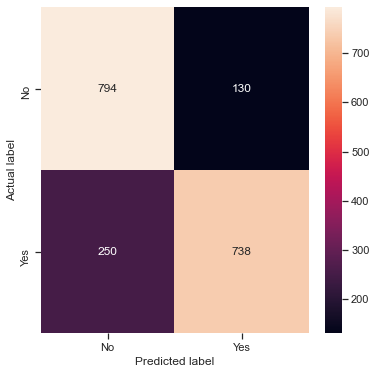

Cross validation result for data 7 is :
0:	learn: 0.6457641	total: 58.5ms	remaining: 11.6s
1:	learn: 0.5995777	total: 121ms	remaining: 12s
2:	learn: 0.5728013	total: 180ms	remaining: 11.8s
3:	learn: 0.5444527	total: 241ms	remaining: 11.8s
4:	learn: 0.5266383	total: 327ms	remaining: 12.8s
5:	learn: 0.5151274	total: 387ms	remaining: 12.5s
6:	learn: 0.5020920	total: 443ms	remaining: 12.2s
7:	learn: 0.4919472	total: 547ms	remaining: 13.1s
8:	learn: 0.4822449	total: 617ms	remaining: 13.1s
9:	learn: 0.4773664	total: 673ms	remaining: 12.8s
10:	learn: 0.4719806	total: 740ms	remaining: 12.7s
11:	learn: 0.4675005	total: 795ms	remaining: 12.5s
12:	learn: 0.4636435	total: 869ms	remaining: 12.5s
13:	learn: 0.4611098	total: 937ms	remaining: 12.4s
14:	learn: 0.4591397	total: 999ms	remaining: 12.3s
15:	learn: 0.4570403	total: 1.06s	remaining: 12.2s
16:	learn: 0.4551547	total: 1.15s	remaining: 12.4s
17:	learn: 0.4540147	total: 1.21s	remaining: 12.3s
18:	learn: 0.4528016	total: 1.27s	remaining: 12.1s
19

161:	learn: 0.4076953	total: 10.9s	remaining: 2.56s
162:	learn: 0.4075912	total: 10.9s	remaining: 2.48s
163:	learn: 0.4073166	total: 11s	remaining: 2.42s
164:	learn: 0.4071157	total: 11.1s	remaining: 2.35s
165:	learn: 0.4069272	total: 11.2s	remaining: 2.3s
166:	learn: 0.4066551	total: 11.3s	remaining: 2.24s
167:	learn: 0.4065796	total: 11.4s	remaining: 2.17s
168:	learn: 0.4062228	total: 11.5s	remaining: 2.11s
169:	learn: 0.4062002	total: 11.5s	remaining: 2.04s
170:	learn: 0.4060161	total: 11.6s	remaining: 1.97s
171:	learn: 0.4058362	total: 11.7s	remaining: 1.91s
172:	learn: 0.4057036	total: 11.8s	remaining: 1.85s
173:	learn: 0.4054242	total: 11.9s	remaining: 1.78s
174:	learn: 0.4052624	total: 12s	remaining: 1.71s
175:	learn: 0.4050738	total: 12s	remaining: 1.64s
176:	learn: 0.4047268	total: 12.1s	remaining: 1.57s
177:	learn: 0.4045912	total: 12.2s	remaining: 1.5s
178:	learn: 0.4043481	total: 12.2s	remaining: 1.43s
179:	learn: 0.4042419	total: 12.3s	remaining: 1.36s
180:	learn: 0.403912

123:	learn: 0.4148254	total: 7.84s	remaining: 4.8s
124:	learn: 0.4142364	total: 7.91s	remaining: 4.74s
125:	learn: 0.4138828	total: 7.97s	remaining: 4.68s
126:	learn: 0.4137037	total: 8.03s	remaining: 4.61s
127:	learn: 0.4136342	total: 8.08s	remaining: 4.54s
128:	learn: 0.4134030	total: 8.14s	remaining: 4.48s
129:	learn: 0.4130973	total: 8.22s	remaining: 4.43s
130:	learn: 0.4128351	total: 8.27s	remaining: 4.36s
131:	learn: 0.4125581	total: 8.34s	remaining: 4.29s
132:	learn: 0.4121503	total: 8.41s	remaining: 4.24s
133:	learn: 0.4118737	total: 8.46s	remaining: 4.17s
134:	learn: 0.4118194	total: 8.51s	remaining: 4.1s
135:	learn: 0.4115645	total: 8.69s	remaining: 4.09s
136:	learn: 0.4113687	total: 8.79s	remaining: 4.04s
137:	learn: 0.4108856	total: 8.85s	remaining: 3.97s
138:	learn: 0.4106972	total: 8.91s	remaining: 3.91s
139:	learn: 0.4106410	total: 8.99s	remaining: 3.85s
140:	learn: 0.4104374	total: 9.04s	remaining: 3.78s
141:	learn: 0.4100789	total: 9.11s	remaining: 3.72s
142:	learn: 0.

85:	learn: 0.4232646	total: 4.98s	remaining: 6.61s
86:	learn: 0.4229134	total: 5.05s	remaining: 6.56s
87:	learn: 0.4225579	total: 5.11s	remaining: 6.5s
88:	learn: 0.4223190	total: 5.16s	remaining: 6.44s
89:	learn: 0.4218090	total: 5.23s	remaining: 6.39s
90:	learn: 0.4214736	total: 5.29s	remaining: 6.33s
91:	learn: 0.4213253	total: 5.35s	remaining: 6.28s
92:	learn: 0.4209156	total: 5.42s	remaining: 6.24s
93:	learn: 0.4206969	total: 5.5s	remaining: 6.21s
94:	learn: 0.4205278	total: 5.6s	remaining: 6.19s
95:	learn: 0.4202266	total: 5.67s	remaining: 6.14s
96:	learn: 0.4199278	total: 5.73s	remaining: 6.08s
97:	learn: 0.4193110	total: 5.79s	remaining: 6.02s
98:	learn: 0.4191757	total: 5.85s	remaining: 5.96s
99:	learn: 0.4185161	total: 5.92s	remaining: 5.92s
100:	learn: 0.4181982	total: 5.97s	remaining: 5.85s
101:	learn: 0.4177507	total: 6.04s	remaining: 5.8s
102:	learn: 0.4175299	total: 6.1s	remaining: 5.74s
103:	learn: 0.4174969	total: 6.15s	remaining: 5.68s
104:	learn: 0.4174342	total: 6.2

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 8 is : 0.8119716334789053
Train f1_score [No]: for data 8 is : 0.8182627889865625
              precision    recall  f1-score   support

          No       0.78      0.84      0.81       924
         Yes       0.84      0.77      0.81       988

    accuracy                           0.81      1912
   macro avg       0.81      0.81      0.81      1912
weighted avg       0.81      0.81      0.81      1912



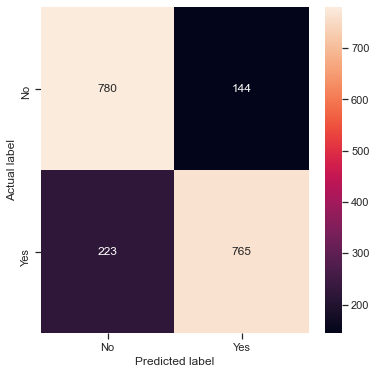

Cross validation result for data 8 is :
0:	learn: 0.6462468	total: 48.3ms	remaining: 9.62s
1:	learn: 0.5969066	total: 99.9ms	remaining: 9.89s
2:	learn: 0.5626447	total: 159ms	remaining: 10.4s
3:	learn: 0.5425519	total: 208ms	remaining: 10.2s
4:	learn: 0.5254380	total: 289ms	remaining: 11.3s
5:	learn: 0.5140207	total: 350ms	remaining: 11.3s
6:	learn: 0.4991198	total: 404ms	remaining: 11.1s
7:	learn: 0.4917475	total: 453ms	remaining: 10.9s
8:	learn: 0.4854937	total: 510ms	remaining: 10.8s
9:	learn: 0.4786112	total: 574ms	remaining: 10.9s
10:	learn: 0.4733411	total: 636ms	remaining: 10.9s
11:	learn: 0.4682895	total: 692ms	remaining: 10.8s
12:	learn: 0.4640478	total: 736ms	remaining: 10.6s
13:	learn: 0.4603177	total: 796ms	remaining: 10.6s
14:	learn: 0.4582351	total: 843ms	remaining: 10.4s
15:	learn: 0.4558098	total: 919ms	remaining: 10.6s
16:	learn: 0.4545269	total: 989ms	remaining: 10.6s
17:	learn: 0.4530990	total: 1.04s	remaining: 10.5s
18:	learn: 0.4515638	total: 1.09s	remaining: 10.4s

162:	learn: 0.4070906	total: 9.39s	remaining: 2.13s
163:	learn: 0.4069884	total: 9.45s	remaining: 2.07s
164:	learn: 0.4069134	total: 9.5s	remaining: 2.01s
165:	learn: 0.4067067	total: 9.57s	remaining: 1.96s
166:	learn: 0.4063842	total: 9.63s	remaining: 1.9s
167:	learn: 0.4062600	total: 9.69s	remaining: 1.85s
168:	learn: 0.4060251	total: 9.75s	remaining: 1.79s
169:	learn: 0.4058850	total: 9.81s	remaining: 1.73s
170:	learn: 0.4057937	total: 9.86s	remaining: 1.67s
171:	learn: 0.4055275	total: 9.93s	remaining: 1.62s
172:	learn: 0.4052248	total: 9.99s	remaining: 1.56s
173:	learn: 0.4050389	total: 10.1s	remaining: 1.51s
174:	learn: 0.4050135	total: 10.1s	remaining: 1.45s
175:	learn: 0.4048787	total: 10.2s	remaining: 1.39s
176:	learn: 0.4046144	total: 10.3s	remaining: 1.33s
177:	learn: 0.4043500	total: 10.3s	remaining: 1.27s
178:	learn: 0.4042495	total: 10.4s	remaining: 1.22s
179:	learn: 0.4041401	total: 10.5s	remaining: 1.16s
180:	learn: 0.4040175	total: 10.5s	remaining: 1.11s
181:	learn: 0.

123:	learn: 0.4109224	total: 8.67s	remaining: 5.31s
124:	learn: 0.4106354	total: 8.72s	remaining: 5.23s
125:	learn: 0.4104262	total: 8.78s	remaining: 5.16s
126:	learn: 0.4104226	total: 8.82s	remaining: 5.07s
127:	learn: 0.4101814	total: 8.88s	remaining: 4.99s
128:	learn: 0.4095908	total: 8.93s	remaining: 4.92s
129:	learn: 0.4094649	total: 8.98s	remaining: 4.84s
130:	learn: 0.4093175	total: 9.04s	remaining: 4.76s
131:	learn: 0.4090745	total: 9.1s	remaining: 4.69s
132:	learn: 0.4088626	total: 9.17s	remaining: 4.62s
133:	learn: 0.4087637	total: 9.25s	remaining: 4.56s
134:	learn: 0.4084297	total: 9.34s	remaining: 4.5s
135:	learn: 0.4082018	total: 9.41s	remaining: 4.43s
136:	learn: 0.4081528	total: 9.46s	remaining: 4.35s
137:	learn: 0.4078809	total: 9.52s	remaining: 4.28s
138:	learn: 0.4077767	total: 9.58s	remaining: 4.2s
139:	learn: 0.4076939	total: 9.65s	remaining: 4.14s
140:	learn: 0.4073899	total: 9.71s	remaining: 4.06s
141:	learn: 0.4070106	total: 9.77s	remaining: 3.99s
142:	learn: 0.4

87:	learn: 0.4187385	total: 5.19s	remaining: 6.61s
88:	learn: 0.4186553	total: 5.28s	remaining: 6.58s
89:	learn: 0.4184407	total: 5.32s	remaining: 6.5s
90:	learn: 0.4179015	total: 5.38s	remaining: 6.44s
91:	learn: 0.4177874	total: 5.43s	remaining: 6.38s
92:	learn: 0.4174317	total: 5.48s	remaining: 6.31s
93:	learn: 0.4172995	total: 5.56s	remaining: 6.27s
94:	learn: 0.4171558	total: 5.63s	remaining: 6.22s
95:	learn: 0.4169562	total: 5.7s	remaining: 6.18s
96:	learn: 0.4168561	total: 5.8s	remaining: 6.15s
97:	learn: 0.4166680	total: 5.87s	remaining: 6.11s
98:	learn: 0.4164535	total: 5.92s	remaining: 6.04s
99:	learn: 0.4162129	total: 5.98s	remaining: 5.98s
100:	learn: 0.4157513	total: 6.06s	remaining: 5.94s
101:	learn: 0.4156421	total: 6.12s	remaining: 5.88s
102:	learn: 0.4152938	total: 6.17s	remaining: 5.81s
103:	learn: 0.4150854	total: 6.23s	remaining: 5.75s
104:	learn: 0.4148239	total: 6.29s	remaining: 5.69s
105:	learn: 0.4144279	total: 6.37s	remaining: 5.65s
106:	learn: 0.4141204	total:

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 9 is : 0.8108021476079815
Train f1_score [No]: for data 9 is : 0.817146840148699
              precision    recall  f1-score   support

          No       0.77      0.87      0.81       924
         Yes       0.86      0.75      0.80       988

    accuracy                           0.81      1912
   macro avg       0.81      0.81      0.81      1912
weighted avg       0.82      0.81      0.81      1912



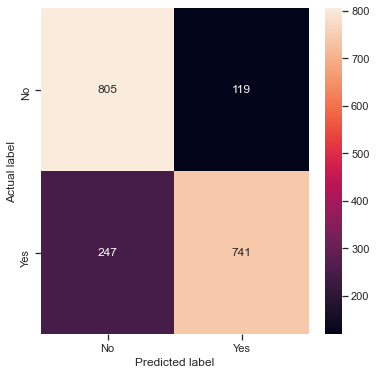

Cross validation result for data 9 is :
0:	learn: 0.6340920	total: 54.2ms	remaining: 10.8s
1:	learn: 0.5935950	total: 118ms	remaining: 11.7s
2:	learn: 0.5701450	total: 166ms	remaining: 10.9s
3:	learn: 0.5464235	total: 219ms	remaining: 10.7s
4:	learn: 0.5285601	total: 267ms	remaining: 10.4s
5:	learn: 0.5154390	total: 336ms	remaining: 10.9s
6:	learn: 0.5033065	total: 404ms	remaining: 11.1s
7:	learn: 0.4939659	total: 489ms	remaining: 11.7s
8:	learn: 0.4856025	total: 560ms	remaining: 11.9s
9:	learn: 0.4802213	total: 608ms	remaining: 11.6s
10:	learn: 0.4756487	total: 692ms	remaining: 11.9s
11:	learn: 0.4700573	total: 741ms	remaining: 11.6s
12:	learn: 0.4670143	total: 827ms	remaining: 11.9s
13:	learn: 0.4644479	total: 896ms	remaining: 11.9s
14:	learn: 0.4605797	total: 956ms	remaining: 11.8s
15:	learn: 0.4589875	total: 1.03s	remaining: 11.8s
16:	learn: 0.4568671	total: 1.08s	remaining: 11.6s
17:	learn: 0.4550243	total: 1.13s	remaining: 11.4s
18:	learn: 0.4532201	total: 1.18s	remaining: 11.2s


163:	learn: 0.4059914	total: 9.44s	remaining: 2.07s
164:	learn: 0.4057223	total: 9.5s	remaining: 2.01s
165:	learn: 0.4053603	total: 9.57s	remaining: 1.96s
166:	learn: 0.4051210	total: 9.62s	remaining: 1.9s
167:	learn: 0.4048390	total: 9.68s	remaining: 1.84s
168:	learn: 0.4047017	total: 9.75s	remaining: 1.79s
169:	learn: 0.4045702	total: 9.81s	remaining: 1.73s
170:	learn: 0.4043557	total: 9.86s	remaining: 1.67s
171:	learn: 0.4042847	total: 9.92s	remaining: 1.61s
172:	learn: 0.4041144	total: 9.98s	remaining: 1.56s
173:	learn: 0.4038620	total: 10s	remaining: 1.5s
174:	learn: 0.4037755	total: 10.1s	remaining: 1.45s
175:	learn: 0.4036271	total: 10.2s	remaining: 1.39s
176:	learn: 0.4033563	total: 10.2s	remaining: 1.33s
177:	learn: 0.4032258	total: 10.3s	remaining: 1.27s
178:	learn: 0.4031327	total: 10.3s	remaining: 1.21s
179:	learn: 0.4030399	total: 10.4s	remaining: 1.15s
180:	learn: 0.4029909	total: 10.4s	remaining: 1.09s
181:	learn: 0.4028173	total: 10.5s	remaining: 1.04s
182:	learn: 0.402

126:	learn: 0.4143353	total: 7.23s	remaining: 4.16s
127:	learn: 0.4141490	total: 7.28s	remaining: 4.1s
128:	learn: 0.4137917	total: 7.34s	remaining: 4.04s
129:	learn: 0.4137119	total: 7.39s	remaining: 3.98s
130:	learn: 0.4134573	total: 7.44s	remaining: 3.92s
131:	learn: 0.4132365	total: 7.5s	remaining: 3.86s
132:	learn: 0.4129991	total: 7.55s	remaining: 3.8s
133:	learn: 0.4129841	total: 7.63s	remaining: 3.76s
134:	learn: 0.4128705	total: 7.68s	remaining: 3.7s
135:	learn: 0.4126717	total: 7.74s	remaining: 3.64s
136:	learn: 0.4125271	total: 7.8s	remaining: 3.58s
137:	learn: 0.4123770	total: 7.86s	remaining: 3.53s
138:	learn: 0.4120614	total: 7.91s	remaining: 3.47s
139:	learn: 0.4118994	total: 7.98s	remaining: 3.42s
140:	learn: 0.4116632	total: 8.04s	remaining: 3.36s
141:	learn: 0.4116619	total: 8.08s	remaining: 3.3s
142:	learn: 0.4116518	total: 8.14s	remaining: 3.24s
143:	learn: 0.4115565	total: 8.19s	remaining: 3.18s
144:	learn: 0.4114463	total: 8.26s	remaining: 3.13s
145:	learn: 0.4112

90:	learn: 0.4220588	total: 5.03s	remaining: 6.03s
91:	learn: 0.4217337	total: 5.08s	remaining: 5.96s
92:	learn: 0.4216372	total: 5.14s	remaining: 5.92s
93:	learn: 0.4212606	total: 5.21s	remaining: 5.88s
94:	learn: 0.4209356	total: 5.27s	remaining: 5.82s
95:	learn: 0.4206996	total: 5.33s	remaining: 5.78s
96:	learn: 0.4200124	total: 5.4s	remaining: 5.73s
97:	learn: 0.4198244	total: 5.46s	remaining: 5.69s
98:	learn: 0.4194951	total: 5.52s	remaining: 5.63s
99:	learn: 0.4189461	total: 5.58s	remaining: 5.58s
100:	learn: 0.4189346	total: 5.59s	remaining: 5.48s
101:	learn: 0.4185157	total: 5.64s	remaining: 5.42s
102:	learn: 0.4179606	total: 5.69s	remaining: 5.36s
103:	learn: 0.4178323	total: 5.76s	remaining: 5.32s
104:	learn: 0.4174793	total: 5.82s	remaining: 5.27s
105:	learn: 0.4173135	total: 5.87s	remaining: 5.21s
106:	learn: 0.4168195	total: 5.94s	remaining: 5.16s
107:	learn: 0.4167341	total: 5.99s	remaining: 5.1s
108:	learn: 0.4165591	total: 6.04s	remaining: 5.04s
109:	learn: 0.4163113	to

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 10 is : 0.8117345713599616
Train f1_score [No]: for data 10 is : 0.8176461466894093
              precision    recall  f1-score   support

          No       0.77      0.83      0.80       924
         Yes       0.83      0.77      0.80       988

    accuracy                           0.80      1912
   macro avg       0.80      0.80      0.80      1912
weighted avg       0.80      0.80      0.80      1912



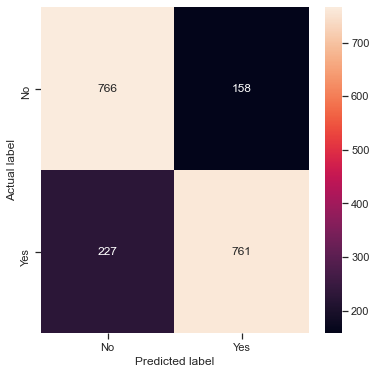

Cross validation result for data 10 is :
0:	learn: 0.6341663	total: 40.6ms	remaining: 8.08s
1:	learn: 0.6013721	total: 90.6ms	remaining: 8.97s
2:	learn: 0.5699707	total: 150ms	remaining: 9.86s
3:	learn: 0.5495256	total: 206ms	remaining: 10.1s
4:	learn: 0.5291589	total: 261ms	remaining: 10.2s
5:	learn: 0.5184082	total: 306ms	remaining: 9.89s
6:	learn: 0.5051757	total: 366ms	remaining: 10.1s
7:	learn: 0.4958517	total: 422ms	remaining: 10.1s
8:	learn: 0.4883560	total: 520ms	remaining: 11s
9:	learn: 0.4816205	total: 573ms	remaining: 10.9s
10:	learn: 0.4768811	total: 622ms	remaining: 10.7s
11:	learn: 0.4725324	total: 674ms	remaining: 10.6s
12:	learn: 0.4687515	total: 728ms	remaining: 10.5s
13:	learn: 0.4659160	total: 790ms	remaining: 10.5s
14:	learn: 0.4640114	total: 829ms	remaining: 10.2s
15:	learn: 0.4622998	total: 898ms	remaining: 10.3s
16:	learn: 0.4601125	total: 973ms	remaining: 10.5s
17:	learn: 0.4582629	total: 1.02s	remaining: 10.4s
18:	learn: 0.4567944	total: 1.11s	remaining: 10.6s


161:	learn: 0.4107251	total: 8.94s	remaining: 2.1s
162:	learn: 0.4106364	total: 8.99s	remaining: 2.04s
163:	learn: 0.4104776	total: 9.05s	remaining: 1.99s
164:	learn: 0.4104260	total: 9.1s	remaining: 1.93s
165:	learn: 0.4104207	total: 9.15s	remaining: 1.87s
166:	learn: 0.4103226	total: 9.22s	remaining: 1.82s
167:	learn: 0.4101967	total: 9.27s	remaining: 1.76s
168:	learn: 0.4100058	total: 9.31s	remaining: 1.71s
169:	learn: 0.4097679	total: 9.36s	remaining: 1.65s
170:	learn: 0.4096607	total: 9.43s	remaining: 1.6s
171:	learn: 0.4095525	total: 9.48s	remaining: 1.54s
172:	learn: 0.4094116	total: 9.53s	remaining: 1.49s
173:	learn: 0.4093081	total: 9.58s	remaining: 1.43s
174:	learn: 0.4089316	total: 9.64s	remaining: 1.38s
175:	learn: 0.4089040	total: 9.69s	remaining: 1.32s
176:	learn: 0.4087155	total: 9.76s	remaining: 1.27s
177:	learn: 0.4086591	total: 9.81s	remaining: 1.21s
178:	learn: 0.4085179	total: 9.87s	remaining: 1.16s
179:	learn: 0.4084239	total: 9.95s	remaining: 1.1s
180:	learn: 0.40

124:	learn: 0.4139500	total: 7.46s	remaining: 4.48s
125:	learn: 0.4136566	total: 7.53s	remaining: 4.42s
126:	learn: 0.4135251	total: 7.58s	remaining: 4.36s
127:	learn: 0.4129247	total: 7.63s	remaining: 4.29s
128:	learn: 0.4127088	total: 7.68s	remaining: 4.23s
129:	learn: 0.4125995	total: 7.75s	remaining: 4.17s
130:	learn: 0.4123887	total: 7.85s	remaining: 4.13s
131:	learn: 0.4122034	total: 7.91s	remaining: 4.08s
132:	learn: 0.4120500	total: 7.97s	remaining: 4.01s
133:	learn: 0.4117736	total: 8.02s	remaining: 3.95s
134:	learn: 0.4116740	total: 8.09s	remaining: 3.89s
135:	learn: 0.4114118	total: 8.16s	remaining: 3.84s
136:	learn: 0.4112796	total: 8.21s	remaining: 3.77s
137:	learn: 0.4110841	total: 8.25s	remaining: 3.71s
138:	learn: 0.4109652	total: 8.3s	remaining: 3.64s
139:	learn: 0.4108629	total: 8.36s	remaining: 3.58s
140:	learn: 0.4106987	total: 8.42s	remaining: 3.52s
141:	learn: 0.4105780	total: 8.48s	remaining: 3.46s
142:	learn: 0.4104156	total: 8.53s	remaining: 3.4s
143:	learn: 0.

86:	learn: 0.4245362	total: 5.02s	remaining: 6.52s
87:	learn: 0.4242051	total: 5.07s	remaining: 6.45s
88:	learn: 0.4239716	total: 5.14s	remaining: 6.41s
89:	learn: 0.4236086	total: 5.21s	remaining: 6.37s
90:	learn: 0.4235159	total: 5.26s	remaining: 6.29s
91:	learn: 0.4234063	total: 5.33s	remaining: 6.25s
92:	learn: 0.4232286	total: 5.38s	remaining: 6.19s
93:	learn: 0.4225885	total: 5.43s	remaining: 6.12s
94:	learn: 0.4222025	total: 5.48s	remaining: 6.06s
95:	learn: 0.4221972	total: 5.51s	remaining: 5.97s
96:	learn: 0.4221237	total: 5.58s	remaining: 5.92s
97:	learn: 0.4219478	total: 5.63s	remaining: 5.86s
98:	learn: 0.4215176	total: 5.68s	remaining: 5.79s
99:	learn: 0.4213014	total: 5.73s	remaining: 5.73s
100:	learn: 0.4211012	total: 5.78s	remaining: 5.66s
101:	learn: 0.4209444	total: 5.82s	remaining: 5.59s
102:	learn: 0.4208910	total: 5.87s	remaining: 5.53s
103:	learn: 0.4206384	total: 5.93s	remaining: 5.47s
104:	learn: 0.4204868	total: 5.97s	remaining: 5.4s
105:	learn: 0.4200298	total

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 11 is : 0.8116314563418748
Train f1_score [No]: for data 11 is : 0.8188069850100448
              precision    recall  f1-score   support

          No       0.78      0.85      0.81       924
         Yes       0.85      0.77      0.81       988

    accuracy                           0.81      1912
   macro avg       0.81      0.81      0.81      1912
weighted avg       0.81      0.81      0.81      1912



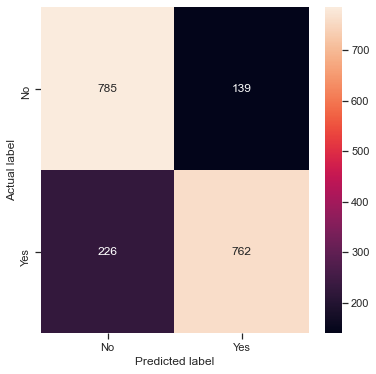

Cross validation result for data 11 is :
0:	learn: 0.6308321	total: 46.1ms	remaining: 9.17s
1:	learn: 0.5873453	total: 103ms	remaining: 10.2s
2:	learn: 0.5658624	total: 151ms	remaining: 9.93s
3:	learn: 0.5464851	total: 195ms	remaining: 9.54s
4:	learn: 0.5266989	total: 243ms	remaining: 9.48s
5:	learn: 0.5129445	total: 302ms	remaining: 9.76s
6:	learn: 0.5024791	total: 352ms	remaining: 9.71s
7:	learn: 0.4939869	total: 411ms	remaining: 9.86s
8:	learn: 0.4865640	total: 493ms	remaining: 10.5s
9:	learn: 0.4788901	total: 560ms	remaining: 10.6s
10:	learn: 0.4741268	total: 605ms	remaining: 10.4s
11:	learn: 0.4701033	total: 654ms	remaining: 10.2s
12:	learn: 0.4653794	total: 720ms	remaining: 10.4s
13:	learn: 0.4627928	total: 775ms	remaining: 10.3s
14:	learn: 0.4597649	total: 817ms	remaining: 10.1s
15:	learn: 0.4574212	total: 862ms	remaining: 9.91s
16:	learn: 0.4560442	total: 915ms	remaining: 9.85s
17:	learn: 0.4547625	total: 948ms	remaining: 9.58s
18:	learn: 0.4536013	total: 994ms	remaining: 9.47s

162:	learn: 0.4028506	total: 9.13s	remaining: 2.07s
163:	learn: 0.4027951	total: 9.18s	remaining: 2.01s
164:	learn: 0.4025644	total: 9.24s	remaining: 1.96s
165:	learn: 0.4024094	total: 9.29s	remaining: 1.9s
166:	learn: 0.4023377	total: 9.34s	remaining: 1.85s
167:	learn: 0.4020143	total: 9.4s	remaining: 1.79s
168:	learn: 0.4017553	total: 9.46s	remaining: 1.73s
169:	learn: 0.4013307	total: 9.51s	remaining: 1.68s
170:	learn: 0.4012724	total: 9.59s	remaining: 1.63s
171:	learn: 0.4011589	total: 9.64s	remaining: 1.57s
172:	learn: 0.4009944	total: 9.69s	remaining: 1.51s
173:	learn: 0.4008847	total: 9.77s	remaining: 1.46s
174:	learn: 0.4006646	total: 9.82s	remaining: 1.4s
175:	learn: 0.4004720	total: 9.88s	remaining: 1.35s
176:	learn: 0.4001453	total: 9.96s	remaining: 1.29s
177:	learn: 0.4000610	total: 10s	remaining: 1.24s
178:	learn: 0.3999190	total: 10.1s	remaining: 1.18s
179:	learn: 0.3998284	total: 10.1s	remaining: 1.12s
180:	learn: 0.3996816	total: 10.2s	remaining: 1.07s
181:	learn: 0.399

123:	learn: 0.4136181	total: 6.92s	remaining: 4.24s
124:	learn: 0.4131434	total: 6.97s	remaining: 4.18s
125:	learn: 0.4128467	total: 7.02s	remaining: 4.13s
126:	learn: 0.4127642	total: 7.08s	remaining: 4.07s
127:	learn: 0.4125031	total: 7.15s	remaining: 4.02s
128:	learn: 0.4121100	total: 7.21s	remaining: 3.97s
129:	learn: 0.4119377	total: 7.29s	remaining: 3.92s
130:	learn: 0.4118431	total: 7.34s	remaining: 3.87s
131:	learn: 0.4116282	total: 7.41s	remaining: 3.82s
132:	learn: 0.4110103	total: 7.46s	remaining: 3.76s
133:	learn: 0.4108488	total: 7.52s	remaining: 3.71s
134:	learn: 0.4107169	total: 7.58s	remaining: 3.65s
135:	learn: 0.4102083	total: 7.64s	remaining: 3.6s
136:	learn: 0.4100274	total: 7.69s	remaining: 3.54s
137:	learn: 0.4097656	total: 7.75s	remaining: 3.48s
138:	learn: 0.4097058	total: 7.8s	remaining: 3.42s
139:	learn: 0.4094172	total: 7.86s	remaining: 3.37s
140:	learn: 0.4090241	total: 7.95s	remaining: 3.33s
141:	learn: 0.4088483	total: 8.01s	remaining: 3.27s
142:	learn: 0.

85:	learn: 0.4227615	total: 4.86s	remaining: 6.44s
86:	learn: 0.4226620	total: 4.91s	remaining: 6.38s
87:	learn: 0.4223725	total: 4.96s	remaining: 6.31s
88:	learn: 0.4221053	total: 5.01s	remaining: 6.24s
89:	learn: 0.4217070	total: 5.08s	remaining: 6.21s
90:	learn: 0.4212802	total: 5.14s	remaining: 6.15s
91:	learn: 0.4211857	total: 5.19s	remaining: 6.09s
92:	learn: 0.4209654	total: 5.24s	remaining: 6.03s
93:	learn: 0.4209431	total: 5.31s	remaining: 5.98s
94:	learn: 0.4206185	total: 5.36s	remaining: 5.92s
95:	learn: 0.4205199	total: 5.41s	remaining: 5.86s
96:	learn: 0.4204347	total: 5.46s	remaining: 5.79s
97:	learn: 0.4203605	total: 5.5s	remaining: 5.73s
98:	learn: 0.4203601	total: 5.53s	remaining: 5.65s
99:	learn: 0.4199901	total: 5.59s	remaining: 5.59s
100:	learn: 0.4198663	total: 5.64s	remaining: 5.53s
101:	learn: 0.4196140	total: 5.69s	remaining: 5.47s
102:	learn: 0.4194007	total: 5.76s	remaining: 5.42s
103:	learn: 0.4192013	total: 5.81s	remaining: 5.37s
104:	learn: 0.4190187	total:

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 12 is : 0.8084969423881557
Train f1_score [No]: for data 12 is : 0.8164005245699298
              precision    recall  f1-score   support

          No       0.77      0.84      0.80       924
         Yes       0.83      0.77      0.80       988

    accuracy                           0.80      1912
   macro avg       0.80      0.80      0.80      1912
weighted avg       0.80      0.80      0.80      1912



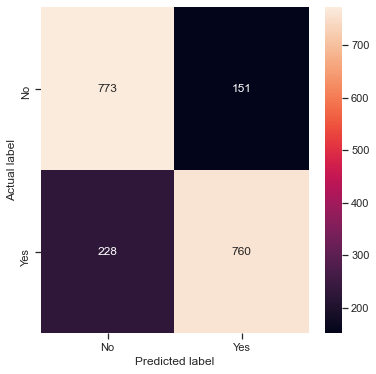

Cross validation result for data 12 is :
0:	learn: 0.6333698	total: 51.6ms	remaining: 10.3s
1:	learn: 0.5995737	total: 103ms	remaining: 10.2s
2:	learn: 0.5732020	total: 154ms	remaining: 10.1s
3:	learn: 0.5477065	total: 200ms	remaining: 9.81s
4:	learn: 0.5294559	total: 267ms	remaining: 10.4s
5:	learn: 0.5135143	total: 313ms	remaining: 10.1s
6:	learn: 0.5019609	total: 359ms	remaining: 9.9s
7:	learn: 0.4940552	total: 416ms	remaining: 9.97s
8:	learn: 0.4854137	total: 500ms	remaining: 10.6s
9:	learn: 0.4794227	total: 554ms	remaining: 10.5s
10:	learn: 0.4745058	total: 610ms	remaining: 10.5s
11:	learn: 0.4708396	total: 667ms	remaining: 10.4s
12:	learn: 0.4671141	total: 712ms	remaining: 10.2s
13:	learn: 0.4640898	total: 759ms	remaining: 10.1s
14:	learn: 0.4616887	total: 807ms	remaining: 9.96s
15:	learn: 0.4588985	total: 851ms	remaining: 9.78s
16:	learn: 0.4567443	total: 893ms	remaining: 9.62s
17:	learn: 0.4543905	total: 950ms	remaining: 9.61s
18:	learn: 0.4525715	total: 1.02s	remaining: 9.68s


163:	learn: 0.4094614	total: 8.96s	remaining: 1.97s
164:	learn: 0.4089998	total: 9.01s	remaining: 1.91s
165:	learn: 0.4088341	total: 9.09s	remaining: 1.86s
166:	learn: 0.4087844	total: 9.16s	remaining: 1.81s
167:	learn: 0.4085455	total: 9.21s	remaining: 1.75s
168:	learn: 0.4079665	total: 9.28s	remaining: 1.7s
169:	learn: 0.4077923	total: 9.33s	remaining: 1.65s
170:	learn: 0.4076998	total: 9.41s	remaining: 1.59s
171:	learn: 0.4075937	total: 9.46s	remaining: 1.54s
172:	learn: 0.4072953	total: 9.53s	remaining: 1.49s
173:	learn: 0.4070254	total: 9.59s	remaining: 1.43s
174:	learn: 0.4067227	total: 9.65s	remaining: 1.38s
175:	learn: 0.4066133	total: 9.71s	remaining: 1.32s
176:	learn: 0.4064974	total: 9.78s	remaining: 1.27s
177:	learn: 0.4063641	total: 9.84s	remaining: 1.22s
178:	learn: 0.4061562	total: 9.89s	remaining: 1.16s
179:	learn: 0.4059343	total: 9.95s	remaining: 1.1s
180:	learn: 0.4058210	total: 10s	remaining: 1.05s
181:	learn: 0.4057257	total: 10.1s	remaining: 994ms
182:	learn: 0.40

125:	learn: 0.4145067	total: 7.67s	remaining: 4.5s
126:	learn: 0.4143891	total: 7.72s	remaining: 4.44s
127:	learn: 0.4143366	total: 7.77s	remaining: 4.37s
128:	learn: 0.4141683	total: 7.82s	remaining: 4.3s
129:	learn: 0.4141462	total: 7.87s	remaining: 4.24s
130:	learn: 0.4139885	total: 7.94s	remaining: 4.18s
131:	learn: 0.4139439	total: 7.98s	remaining: 4.11s
132:	learn: 0.4135430	total: 8.03s	remaining: 4.05s
133:	learn: 0.4133749	total: 8.08s	remaining: 3.98s
134:	learn: 0.4132430	total: 8.14s	remaining: 3.92s
135:	learn: 0.4130634	total: 8.19s	remaining: 3.85s
136:	learn: 0.4127566	total: 8.24s	remaining: 3.79s
137:	learn: 0.4127306	total: 8.29s	remaining: 3.73s
138:	learn: 0.4125827	total: 8.34s	remaining: 3.66s
139:	learn: 0.4124455	total: 8.39s	remaining: 3.6s
140:	learn: 0.4121531	total: 8.44s	remaining: 3.53s
141:	learn: 0.4120982	total: 8.48s	remaining: 3.47s
142:	learn: 0.4118282	total: 8.54s	remaining: 3.4s
143:	learn: 0.4117020	total: 8.59s	remaining: 3.34s
144:	learn: 0.41

87:	learn: 0.4237527	total: 4.23s	remaining: 5.39s
88:	learn: 0.4234384	total: 4.29s	remaining: 5.34s
89:	learn: 0.4231205	total: 4.34s	remaining: 5.3s
90:	learn: 0.4229509	total: 4.39s	remaining: 5.26s
91:	learn: 0.4228273	total: 4.44s	remaining: 5.21s
92:	learn: 0.4227376	total: 4.48s	remaining: 5.16s
93:	learn: 0.4224374	total: 4.53s	remaining: 5.11s
94:	learn: 0.4222614	total: 4.58s	remaining: 5.07s
95:	learn: 0.4221165	total: 4.67s	remaining: 5.05s
96:	learn: 0.4218090	total: 4.71s	remaining: 5s
97:	learn: 0.4216675	total: 4.76s	remaining: 4.96s
98:	learn: 0.4214734	total: 4.81s	remaining: 4.91s
99:	learn: 0.4212227	total: 4.87s	remaining: 4.87s
100:	learn: 0.4212227	total: 4.88s	remaining: 4.79s
101:	learn: 0.4210492	total: 4.93s	remaining: 4.74s
102:	learn: 0.4208630	total: 4.98s	remaining: 4.69s
103:	learn: 0.4205292	total: 5.03s	remaining: 4.64s
104:	learn: 0.4201939	total: 5.08s	remaining: 4.6s
105:	learn: 0.4199758	total: 5.13s	remaining: 4.55s
106:	learn: 0.4198267	total: 5

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 13 is : 0.811365557210126
Train f1_score [No]: for data 13 is : 0.8192789666473876
              precision    recall  f1-score   support

          No       0.78      0.83      0.80       924
         Yes       0.83      0.79      0.81       988

    accuracy                           0.81      1912
   macro avg       0.81      0.81      0.81      1912
weighted avg       0.81      0.81      0.81      1912



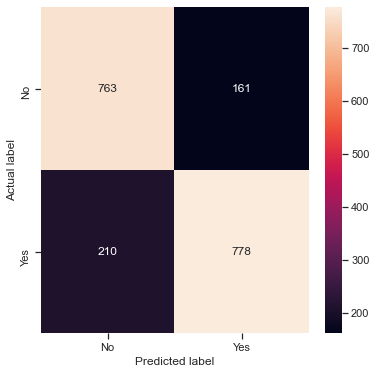

Cross validation result for data 13 is :
0:	learn: 0.6368363	total: 45.1ms	remaining: 8.97s
1:	learn: 0.5967888	total: 96.5ms	remaining: 9.55s
2:	learn: 0.5702287	total: 146ms	remaining: 9.58s
3:	learn: 0.5491855	total: 200ms	remaining: 9.81s
4:	learn: 0.5309973	total: 250ms	remaining: 9.76s
5:	learn: 0.5129883	total: 303ms	remaining: 9.81s
6:	learn: 0.5028870	total: 346ms	remaining: 9.53s
7:	learn: 0.4921812	total: 397ms	remaining: 9.54s
8:	learn: 0.4834296	total: 448ms	remaining: 9.51s
9:	learn: 0.4770609	total: 494ms	remaining: 9.39s
10:	learn: 0.4723575	total: 540ms	remaining: 9.29s
11:	learn: 0.4687128	total: 591ms	remaining: 9.26s
12:	learn: 0.4633309	total: 640ms	remaining: 9.21s
13:	learn: 0.4605048	total: 689ms	remaining: 9.15s
14:	learn: 0.4583860	total: 736ms	remaining: 9.07s
15:	learn: 0.4562266	total: 786ms	remaining: 9.04s
16:	learn: 0.4538158	total: 835ms	remaining: 8.99s
17:	learn: 0.4523485	total: 886ms	remaining: 8.96s
18:	learn: 0.4507224	total: 942ms	remaining: 8.97

160:	learn: 0.4051594	total: 9.09s	remaining: 2.2s
161:	learn: 0.4049069	total: 9.14s	remaining: 2.14s
162:	learn: 0.4048617	total: 9.19s	remaining: 2.09s
163:	learn: 0.4045969	total: 9.26s	remaining: 2.03s
164:	learn: 0.4043196	total: 9.31s	remaining: 1.97s
165:	learn: 0.4040533	total: 9.35s	remaining: 1.92s
166:	learn: 0.4040060	total: 9.4s	remaining: 1.86s
167:	learn: 0.4038893	total: 9.46s	remaining: 1.8s
168:	learn: 0.4035852	total: 9.51s	remaining: 1.74s
169:	learn: 0.4034975	total: 9.56s	remaining: 1.69s
170:	learn: 0.4033575	total: 9.61s	remaining: 1.63s
171:	learn: 0.4032062	total: 9.66s	remaining: 1.57s
172:	learn: 0.4030753	total: 9.71s	remaining: 1.52s
173:	learn: 0.4027232	total: 9.77s	remaining: 1.46s
174:	learn: 0.4022911	total: 9.82s	remaining: 1.4s
175:	learn: 0.4020582	total: 9.88s	remaining: 1.35s
176:	learn: 0.4019824	total: 9.93s	remaining: 1.29s
177:	learn: 0.4019173	total: 10s	remaining: 1.24s
178:	learn: 0.4018443	total: 10.1s	remaining: 1.18s
179:	learn: 0.4013

121:	learn: 0.4108909	total: 7.18s	remaining: 4.59s
122:	learn: 0.4106206	total: 7.24s	remaining: 4.53s
123:	learn: 0.4102018	total: 7.29s	remaining: 4.47s
124:	learn: 0.4101560	total: 7.38s	remaining: 4.43s
125:	learn: 0.4100361	total: 7.43s	remaining: 4.36s
126:	learn: 0.4098649	total: 7.49s	remaining: 4.3s
127:	learn: 0.4095604	total: 7.55s	remaining: 4.24s
128:	learn: 0.4092857	total: 7.61s	remaining: 4.19s
129:	learn: 0.4090696	total: 7.67s	remaining: 4.13s
130:	learn: 0.4089636	total: 7.72s	remaining: 4.07s
131:	learn: 0.4088106	total: 7.81s	remaining: 4.02s
132:	learn: 0.4087183	total: 7.86s	remaining: 3.96s
133:	learn: 0.4085649	total: 7.91s	remaining: 3.89s
134:	learn: 0.4084517	total: 7.95s	remaining: 3.83s
135:	learn: 0.4083516	total: 8s	remaining: 3.77s
136:	learn: 0.4080222	total: 8.06s	remaining: 3.71s
137:	learn: 0.4077422	total: 8.12s	remaining: 3.65s
138:	learn: 0.4076321	total: 8.17s	remaining: 3.59s
139:	learn: 0.4073385	total: 8.26s	remaining: 3.54s
140:	learn: 0.40

85:	learn: 0.4239394	total: 4.77s	remaining: 6.32s
86:	learn: 0.4238481	total: 4.82s	remaining: 6.26s
87:	learn: 0.4233702	total: 4.88s	remaining: 6.21s
88:	learn: 0.4232022	total: 4.94s	remaining: 6.16s
89:	learn: 0.4230830	total: 4.99s	remaining: 6.1s
90:	learn: 0.4226383	total: 5.04s	remaining: 6.03s
91:	learn: 0.4224846	total: 5.08s	remaining: 5.96s
92:	learn: 0.4222041	total: 5.16s	remaining: 5.93s
93:	learn: 0.4220100	total: 5.21s	remaining: 5.87s
94:	learn: 0.4216792	total: 5.25s	remaining: 5.81s
95:	learn: 0.4212535	total: 5.3s	remaining: 5.74s
96:	learn: 0.4211492	total: 5.38s	remaining: 5.71s
97:	learn: 0.4208209	total: 5.43s	remaining: 5.66s
98:	learn: 0.4207256	total: 5.49s	remaining: 5.6s
99:	learn: 0.4204566	total: 5.54s	remaining: 5.54s
100:	learn: 0.4200357	total: 5.59s	remaining: 5.48s
101:	learn: 0.4199019	total: 5.63s	remaining: 5.41s
102:	learn: 0.4194966	total: 5.7s	remaining: 5.36s
103:	learn: 0.4192592	total: 5.74s	remaining: 5.3s
104:	learn: 0.4191882	total: 5.8

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 14 is : 0.8204247844139253
Train f1_score [No]: for data 14 is : 0.8252117820781844
              precision    recall  f1-score   support

          No       0.78      0.85      0.81       924
         Yes       0.84      0.77      0.81       988

    accuracy                           0.81      1912
   macro avg       0.81      0.81      0.81      1912
weighted avg       0.81      0.81      0.81      1912



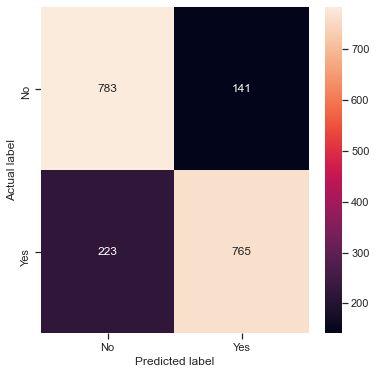

Cross validation result for data 14 is :
0:	learn: 0.6337979	total: 53.1ms	remaining: 10.6s
1:	learn: 0.5976799	total: 144ms	remaining: 14.2s
2:	learn: 0.5652215	total: 220ms	remaining: 14.4s
3:	learn: 0.5434876	total: 291ms	remaining: 14.3s
4:	learn: 0.5250698	total: 351ms	remaining: 13.7s
5:	learn: 0.5124814	total: 393ms	remaining: 12.7s
6:	learn: 0.5025567	total: 438ms	remaining: 12.1s
7:	learn: 0.4901782	total: 486ms	remaining: 11.7s
8:	learn: 0.4822422	total: 541ms	remaining: 11.5s
9:	learn: 0.4757427	total: 606ms	remaining: 11.5s
10:	learn: 0.4677009	total: 653ms	remaining: 11.2s
11:	learn: 0.4641357	total: 701ms	remaining: 11s
12:	learn: 0.4602823	total: 747ms	remaining: 10.8s
13:	learn: 0.4575911	total: 799ms	remaining: 10.6s
14:	learn: 0.4543675	total: 864ms	remaining: 10.7s
15:	learn: 0.4527601	total: 916ms	remaining: 10.5s
16:	learn: 0.4499057	total: 983ms	remaining: 10.6s
17:	learn: 0.4478098	total: 1.05s	remaining: 10.6s
18:	learn: 0.4460882	total: 1.1s	remaining: 10.5s
19

161:	learn: 0.3964040	total: 8.91s	remaining: 2.09s
162:	learn: 0.3962979	total: 8.99s	remaining: 2.04s
163:	learn: 0.3962501	total: 9.04s	remaining: 1.98s
164:	learn: 0.3961800	total: 9.09s	remaining: 1.93s
165:	learn: 0.3961260	total: 9.14s	remaining: 1.87s
166:	learn: 0.3959518	total: 9.19s	remaining: 1.81s
167:	learn: 0.3958358	total: 9.23s	remaining: 1.76s
168:	learn: 0.3956824	total: 9.28s	remaining: 1.7s
169:	learn: 0.3953943	total: 9.35s	remaining: 1.65s
170:	learn: 0.3953730	total: 9.41s	remaining: 1.59s
171:	learn: 0.3951942	total: 9.46s	remaining: 1.54s
172:	learn: 0.3949938	total: 9.5s	remaining: 1.48s
173:	learn: 0.3947865	total: 9.54s	remaining: 1.43s
174:	learn: 0.3946485	total: 9.59s	remaining: 1.37s
175:	learn: 0.3945380	total: 9.64s	remaining: 1.31s
176:	learn: 0.3944228	total: 9.71s	remaining: 1.26s
177:	learn: 0.3942943	total: 9.77s	remaining: 1.21s
178:	learn: 0.3941929	total: 9.81s	remaining: 1.15s
179:	learn: 0.3940261	total: 9.86s	remaining: 1.09s
180:	learn: 0.

125:	learn: 0.4067966	total: 6.67s	remaining: 3.92s
126:	learn: 0.4064365	total: 6.71s	remaining: 3.86s
127:	learn: 0.4062237	total: 6.76s	remaining: 3.8s
128:	learn: 0.4061255	total: 6.81s	remaining: 3.75s
129:	learn: 0.4055360	total: 6.87s	remaining: 3.7s
130:	learn: 0.4053147	total: 6.93s	remaining: 3.65s
131:	learn: 0.4049297	total: 6.99s	remaining: 3.6s
132:	learn: 0.4048599	total: 7.05s	remaining: 3.55s
133:	learn: 0.4045014	total: 7.12s	remaining: 3.51s
134:	learn: 0.4041168	total: 7.17s	remaining: 3.45s
135:	learn: 0.4038952	total: 7.23s	remaining: 3.4s
136:	learn: 0.4037882	total: 7.28s	remaining: 3.35s
137:	learn: 0.4037168	total: 7.33s	remaining: 3.29s
138:	learn: 0.4035608	total: 7.38s	remaining: 3.24s
139:	learn: 0.4029992	total: 7.45s	remaining: 3.19s
140:	learn: 0.4027682	total: 7.51s	remaining: 3.14s
141:	learn: 0.4027452	total: 7.56s	remaining: 3.09s
142:	learn: 0.4024862	total: 7.61s	remaining: 3.03s
143:	learn: 0.4022929	total: 7.67s	remaining: 2.98s
144:	learn: 0.40

86:	learn: 0.4159683	total: 4.8s	remaining: 6.24s
87:	learn: 0.4157310	total: 4.86s	remaining: 6.19s
88:	learn: 0.4156548	total: 4.91s	remaining: 6.12s
89:	learn: 0.4156437	total: 4.94s	remaining: 6.04s
90:	learn: 0.4154284	total: 4.98s	remaining: 5.97s
91:	learn: 0.4152585	total: 5.04s	remaining: 5.92s
92:	learn: 0.4149748	total: 5.09s	remaining: 5.85s
93:	learn: 0.4147198	total: 5.14s	remaining: 5.79s
94:	learn: 0.4143833	total: 5.18s	remaining: 5.72s
95:	learn: 0.4141820	total: 5.23s	remaining: 5.67s
96:	learn: 0.4138251	total: 5.31s	remaining: 5.63s
97:	learn: 0.4135402	total: 5.36s	remaining: 5.58s
98:	learn: 0.4132994	total: 5.42s	remaining: 5.53s
99:	learn: 0.4129257	total: 5.49s	remaining: 5.49s
100:	learn: 0.4124537	total: 5.55s	remaining: 5.44s
101:	learn: 0.4123384	total: 5.59s	remaining: 5.38s
102:	learn: 0.4118909	total: 5.65s	remaining: 5.32s
103:	learn: 0.4117162	total: 5.7s	remaining: 5.26s
104:	learn: 0.4113785	total: 5.75s	remaining: 5.21s
105:	learn: 0.4113120	total:

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 15 is : 0.8147165259348613
Train f1_score [No]: for data 15 is : 0.8221673355974067
              precision    recall  f1-score   support

          No       0.77      0.84      0.81       924
         Yes       0.84      0.77      0.80       988

    accuracy                           0.80      1912
   macro avg       0.81      0.81      0.80      1912
weighted avg       0.81      0.80      0.80      1912



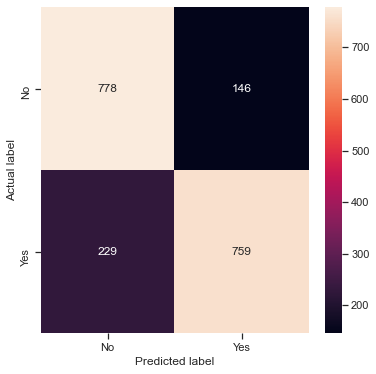

Cross validation result for data 15 is :
0:	learn: 0.6351991	total: 52.4ms	remaining: 10.4s
1:	learn: 0.5958077	total: 114ms	remaining: 11.2s
2:	learn: 0.5639694	total: 162ms	remaining: 10.6s
3:	learn: 0.5454793	total: 238ms	remaining: 11.7s
4:	learn: 0.5278574	total: 286ms	remaining: 11.1s
5:	learn: 0.5149040	total: 329ms	remaining: 10.6s
6:	learn: 0.5036456	total: 374ms	remaining: 10.3s
7:	learn: 0.4951901	total: 422ms	remaining: 10.1s
8:	learn: 0.4843349	total: 471ms	remaining: 9.98s
9:	learn: 0.4791368	total: 529ms	remaining: 10.1s
10:	learn: 0.4737859	total: 579ms	remaining: 9.95s
11:	learn: 0.4677908	total: 642ms	remaining: 10.1s
12:	learn: 0.4651357	total: 692ms	remaining: 9.95s
13:	learn: 0.4625140	total: 781ms	remaining: 10.4s
14:	learn: 0.4603049	total: 838ms	remaining: 10.3s
15:	learn: 0.4571468	total: 891ms	remaining: 10.3s
16:	learn: 0.4553153	total: 941ms	remaining: 10.1s
17:	learn: 0.4540789	total: 1000ms	remaining: 10.1s
18:	learn: 0.4528774	total: 1.07s	remaining: 10.2

160:	learn: 0.4038700	total: 9.32s	remaining: 2.26s
161:	learn: 0.4037111	total: 9.37s	remaining: 2.2s
162:	learn: 0.4035211	total: 9.43s	remaining: 2.14s
163:	learn: 0.4034361	total: 9.49s	remaining: 2.08s
164:	learn: 0.4032064	total: 9.55s	remaining: 2.02s
165:	learn: 0.4029673	total: 9.61s	remaining: 1.97s
166:	learn: 0.4026723	total: 9.67s	remaining: 1.91s
167:	learn: 0.4025909	total: 9.73s	remaining: 1.85s
168:	learn: 0.4024997	total: 9.79s	remaining: 1.79s
169:	learn: 0.4024052	total: 9.84s	remaining: 1.74s
170:	learn: 0.4023969	total: 9.89s	remaining: 1.68s
171:	learn: 0.4022469	total: 9.95s	remaining: 1.62s
172:	learn: 0.4021138	total: 10s	remaining: 1.56s
173:	learn: 0.4019948	total: 10.1s	remaining: 1.5s
174:	learn: 0.4019146	total: 10.1s	remaining: 1.45s
175:	learn: 0.4017873	total: 10.2s	remaining: 1.39s
176:	learn: 0.4017150	total: 10.2s	remaining: 1.33s
177:	learn: 0.4015581	total: 10.3s	remaining: 1.27s
178:	learn: 0.4015122	total: 10.3s	remaining: 1.21s
179:	learn: 0.40

123:	learn: 0.4090943	total: 6.96s	remaining: 4.27s
124:	learn: 0.4089619	total: 7.03s	remaining: 4.22s
125:	learn: 0.4088030	total: 7.08s	remaining: 4.16s
126:	learn: 0.4086341	total: 7.14s	remaining: 4.1s
127:	learn: 0.4083838	total: 7.19s	remaining: 4.04s
128:	learn: 0.4082875	total: 7.26s	remaining: 3.99s
129:	learn: 0.4080946	total: 7.33s	remaining: 3.94s
130:	learn: 0.4080664	total: 7.38s	remaining: 3.89s
131:	learn: 0.4079572	total: 7.44s	remaining: 3.83s
132:	learn: 0.4076869	total: 7.5s	remaining: 3.78s
133:	learn: 0.4073219	total: 7.55s	remaining: 3.72s
134:	learn: 0.4070069	total: 7.61s	remaining: 3.66s
135:	learn: 0.4067732	total: 7.66s	remaining: 3.6s
136:	learn: 0.4064832	total: 7.72s	remaining: 3.55s
137:	learn: 0.4063037	total: 7.78s	remaining: 3.5s
138:	learn: 0.4060649	total: 7.84s	remaining: 3.44s
139:	learn: 0.4059247	total: 7.9s	remaining: 3.38s
140:	learn: 0.4057819	total: 7.95s	remaining: 3.33s
141:	learn: 0.4056510	total: 8.01s	remaining: 3.27s
142:	learn: 0.405

88:	learn: 0.4179900	total: 5.19s	remaining: 6.47s
89:	learn: 0.4179233	total: 5.25s	remaining: 6.42s
90:	learn: 0.4172342	total: 5.32s	remaining: 6.37s
91:	learn: 0.4168983	total: 5.37s	remaining: 6.31s
92:	learn: 0.4167286	total: 5.43s	remaining: 6.25s
93:	learn: 0.4165078	total: 5.49s	remaining: 6.19s
94:	learn: 0.4164348	total: 5.54s	remaining: 6.12s
95:	learn: 0.4164346	total: 5.56s	remaining: 6.02s
96:	learn: 0.4162722	total: 5.61s	remaining: 5.96s
97:	learn: 0.4161532	total: 5.66s	remaining: 5.89s
98:	learn: 0.4160625	total: 5.71s	remaining: 5.83s
99:	learn: 0.4157439	total: 5.77s	remaining: 5.77s
100:	learn: 0.4153380	total: 5.84s	remaining: 5.73s
101:	learn: 0.4149516	total: 5.9s	remaining: 5.67s
102:	learn: 0.4144433	total: 5.96s	remaining: 5.61s
103:	learn: 0.4142322	total: 6.02s	remaining: 5.56s
104:	learn: 0.4140921	total: 6.08s	remaining: 5.5s
105:	learn: 0.4140620	total: 6.12s	remaining: 5.43s
106:	learn: 0.4135216	total: 6.19s	remaining: 5.38s
107:	learn: 0.4129357	tota

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 16 is : 0.8117807998712481
Train f1_score [No]: for data 16 is : 0.8195772909595803
              precision    recall  f1-score   support

          No       0.78      0.87      0.82       924
         Yes       0.86      0.77      0.81       988

    accuracy                           0.82      1912
   macro avg       0.82      0.82      0.82      1912
weighted avg       0.82      0.82      0.82      1912



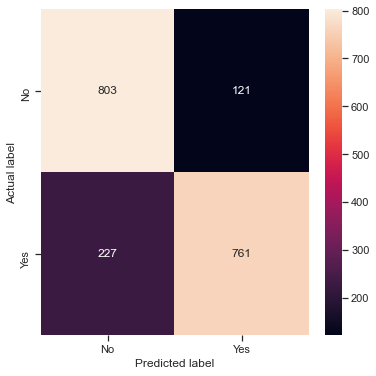

Cross validation result for data 16 is :
0:	learn: 0.6462342	total: 56ms	remaining: 11.2s
1:	learn: 0.6019670	total: 118ms	remaining: 11.7s
2:	learn: 0.5693139	total: 176ms	remaining: 11.6s
3:	learn: 0.5442434	total: 233ms	remaining: 11.4s
4:	learn: 0.5287868	total: 301ms	remaining: 11.7s
5:	learn: 0.5101808	total: 351ms	remaining: 11.4s
6:	learn: 0.5002164	total: 426ms	remaining: 11.7s
7:	learn: 0.4920310	total: 478ms	remaining: 11.5s
8:	learn: 0.4838671	total: 541ms	remaining: 11.5s
9:	learn: 0.4779270	total: 596ms	remaining: 11.3s
10:	learn: 0.4717336	total: 660ms	remaining: 11.3s
11:	learn: 0.4665878	total: 716ms	remaining: 11.2s
12:	learn: 0.4632608	total: 761ms	remaining: 10.9s
13:	learn: 0.4608159	total: 806ms	remaining: 10.7s
14:	learn: 0.4585529	total: 857ms	remaining: 10.6s
15:	learn: 0.4568452	total: 910ms	remaining: 10.5s
16:	learn: 0.4545753	total: 971ms	remaining: 10.5s
17:	learn: 0.4526194	total: 1.03s	remaining: 10.5s
18:	learn: 0.4512742	total: 1.08s	remaining: 10.3s
1

162:	learn: 0.4051330	total: 9.96s	remaining: 2.26s
163:	learn: 0.4049862	total: 10s	remaining: 2.2s
164:	learn: 0.4048591	total: 10.1s	remaining: 2.14s
165:	learn: 0.4046761	total: 10.1s	remaining: 2.08s
166:	learn: 0.4044942	total: 10.2s	remaining: 2.02s
167:	learn: 0.4043809	total: 10.3s	remaining: 1.96s
168:	learn: 0.4042297	total: 10.4s	remaining: 1.9s
169:	learn: 0.4041675	total: 10.4s	remaining: 1.84s
170:	learn: 0.4040241	total: 10.5s	remaining: 1.77s
171:	learn: 0.4040106	total: 10.5s	remaining: 1.71s
172:	learn: 0.4038578	total: 10.6s	remaining: 1.65s
173:	learn: 0.4037540	total: 10.6s	remaining: 1.59s
174:	learn: 0.4036091	total: 10.7s	remaining: 1.53s
175:	learn: 0.4033138	total: 10.8s	remaining: 1.47s
176:	learn: 0.4033015	total: 10.8s	remaining: 1.4s
177:	learn: 0.4030561	total: 10.9s	remaining: 1.34s
178:	learn: 0.4029449	total: 10.9s	remaining: 1.28s
179:	learn: 0.4028885	total: 11s	remaining: 1.22s
180:	learn: 0.4027364	total: 11s	remaining: 1.16s
181:	learn: 0.4026504

126:	learn: 0.4113695	total: 7.8s	remaining: 4.48s
127:	learn: 0.4112075	total: 7.85s	remaining: 4.42s
128:	learn: 0.4108436	total: 7.91s	remaining: 4.35s
129:	learn: 0.4108063	total: 7.96s	remaining: 4.29s
130:	learn: 0.4106864	total: 8.02s	remaining: 4.22s
131:	learn: 0.4104827	total: 8.07s	remaining: 4.16s
132:	learn: 0.4103589	total: 8.13s	remaining: 4.1s
133:	learn: 0.4099589	total: 8.2s	remaining: 4.04s
134:	learn: 0.4096744	total: 8.32s	remaining: 4.01s
135:	learn: 0.4095995	total: 8.38s	remaining: 3.94s
136:	learn: 0.4094235	total: 8.44s	remaining: 3.88s
137:	learn: 0.4093630	total: 8.49s	remaining: 3.81s
138:	learn: 0.4092184	total: 8.55s	remaining: 3.75s
139:	learn: 0.4088699	total: 8.61s	remaining: 3.69s
140:	learn: 0.4086131	total: 8.66s	remaining: 3.63s
141:	learn: 0.4085376	total: 8.72s	remaining: 3.56s
142:	learn: 0.4084114	total: 8.78s	remaining: 3.5s
143:	learn: 0.4083266	total: 8.83s	remaining: 3.43s
144:	learn: 0.4082213	total: 8.9s	remaining: 3.38s
145:	learn: 0.407

87:	learn: 0.4240413	total: 4.99s	remaining: 6.35s
88:	learn: 0.4238262	total: 5.04s	remaining: 6.29s
89:	learn: 0.4234218	total: 5.1s	remaining: 6.23s
90:	learn: 0.4232611	total: 5.16s	remaining: 6.17s
91:	learn: 0.4231058	total: 5.2s	remaining: 6.11s
92:	learn: 0.4228190	total: 5.26s	remaining: 6.05s
93:	learn: 0.4226382	total: 5.31s	remaining: 5.99s
94:	learn: 0.4226018	total: 5.36s	remaining: 5.92s
95:	learn: 0.4225278	total: 5.41s	remaining: 5.86s
96:	learn: 0.4223646	total: 5.45s	remaining: 5.79s
97:	learn: 0.4221897	total: 5.5s	remaining: 5.73s
98:	learn: 0.4216296	total: 5.56s	remaining: 5.67s
99:	learn: 0.4215315	total: 5.63s	remaining: 5.63s
100:	learn: 0.4213828	total: 5.69s	remaining: 5.58s
101:	learn: 0.4210613	total: 5.75s	remaining: 5.53s
102:	learn: 0.4207906	total: 5.82s	remaining: 5.48s
103:	learn: 0.4204956	total: 5.88s	remaining: 5.43s
104:	learn: 0.4202735	total: 5.93s	remaining: 5.37s
105:	learn: 0.4198770	total: 5.98s	remaining: 5.31s
106:	learn: 0.4191968	total:

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 17 is : 0.8134102553758018
Train f1_score [No]: for data 17 is : 0.8220811694556646
              precision    recall  f1-score   support

          No       0.76      0.85      0.80       924
         Yes       0.84      0.76      0.80       988

    accuracy                           0.80      1912
   macro avg       0.80      0.80      0.80      1912
weighted avg       0.80      0.80      0.80      1912



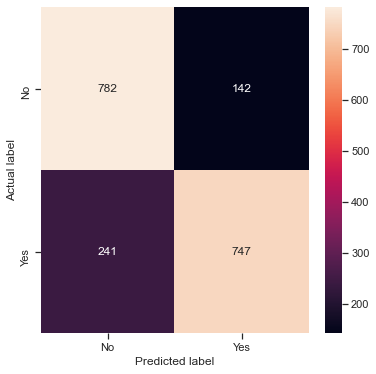

Cross validation result for data 17 is :
0:	learn: 0.6332397	total: 47.1ms	remaining: 9.37s
1:	learn: 0.5989492	total: 99.8ms	remaining: 9.88s
2:	learn: 0.5714291	total: 150ms	remaining: 9.86s
3:	learn: 0.5495678	total: 202ms	remaining: 9.91s
4:	learn: 0.5258845	total: 273ms	remaining: 10.7s
5:	learn: 0.5088760	total: 330ms	remaining: 10.7s
6:	learn: 0.4967183	total: 378ms	remaining: 10.4s
7:	learn: 0.4882346	total: 426ms	remaining: 10.2s
8:	learn: 0.4802676	total: 503ms	remaining: 10.7s
9:	learn: 0.4752412	total: 575ms	remaining: 10.9s
10:	learn: 0.4716470	total: 611ms	remaining: 10.5s
11:	learn: 0.4675942	total: 665ms	remaining: 10.4s
12:	learn: 0.4643050	total: 711ms	remaining: 10.2s
13:	learn: 0.4610359	total: 774ms	remaining: 10.3s
14:	learn: 0.4578527	total: 826ms	remaining: 10.2s
15:	learn: 0.4557632	total: 895ms	remaining: 10.3s
16:	learn: 0.4541191	total: 946ms	remaining: 10.2s
17:	learn: 0.4523915	total: 1.05s	remaining: 10.6s
18:	learn: 0.4494177	total: 1.1s	remaining: 10.5s

161:	learn: 0.4046404	total: 9.61s	remaining: 2.25s
162:	learn: 0.4046025	total: 9.66s	remaining: 2.19s
163:	learn: 0.4044291	total: 9.73s	remaining: 2.14s
164:	learn: 0.4038989	total: 9.78s	remaining: 2.07s
165:	learn: 0.4038106	total: 9.83s	remaining: 2.01s
166:	learn: 0.4033409	total: 9.89s	remaining: 1.95s
167:	learn: 0.4031008	total: 9.94s	remaining: 1.89s
168:	learn: 0.4029560	total: 10s	remaining: 1.84s
169:	learn: 0.4027543	total: 10.1s	remaining: 1.78s
170:	learn: 0.4025802	total: 10.1s	remaining: 1.72s
171:	learn: 0.4024036	total: 10.2s	remaining: 1.66s
172:	learn: 0.4020849	total: 10.2s	remaining: 1.6s
173:	learn: 0.4020118	total: 10.3s	remaining: 1.54s
174:	learn: 0.4018112	total: 10.3s	remaining: 1.48s
175:	learn: 0.4016411	total: 10.4s	remaining: 1.42s
176:	learn: 0.4012397	total: 10.5s	remaining: 1.36s
177:	learn: 0.4012222	total: 10.5s	remaining: 1.3s
178:	learn: 0.4011920	total: 10.6s	remaining: 1.24s
179:	learn: 0.4010284	total: 10.7s	remaining: 1.18s
180:	learn: 0.40

125:	learn: 0.4057175	total: 7.03s	remaining: 4.13s
126:	learn: 0.4054429	total: 7.11s	remaining: 4.09s
127:	learn: 0.4054385	total: 7.17s	remaining: 4.03s
128:	learn: 0.4051120	total: 7.23s	remaining: 3.98s
129:	learn: 0.4050982	total: 7.29s	remaining: 3.92s
130:	learn: 0.4047848	total: 7.33s	remaining: 3.86s
131:	learn: 0.4047555	total: 7.38s	remaining: 3.8s
132:	learn: 0.4045893	total: 7.44s	remaining: 3.75s
133:	learn: 0.4043468	total: 7.5s	remaining: 3.7s
134:	learn: 0.4040392	total: 7.56s	remaining: 3.64s
135:	learn: 0.4038068	total: 7.62s	remaining: 3.58s
136:	learn: 0.4038064	total: 7.67s	remaining: 3.52s
137:	learn: 0.4034920	total: 7.74s	remaining: 3.48s
138:	learn: 0.4031487	total: 7.79s	remaining: 3.42s
139:	learn: 0.4028072	total: 7.87s	remaining: 3.37s
140:	learn: 0.4026690	total: 7.91s	remaining: 3.31s
141:	learn: 0.4023462	total: 7.99s	remaining: 3.26s
142:	learn: 0.4020842	total: 8.06s	remaining: 3.21s
143:	learn: 0.4019171	total: 8.11s	remaining: 3.15s
144:	learn: 0.4

88:	learn: 0.4191695	total: 4.7s	remaining: 5.86s
89:	learn: 0.4189882	total: 4.75s	remaining: 5.8s
90:	learn: 0.4186784	total: 4.8s	remaining: 5.75s
91:	learn: 0.4185488	total: 4.84s	remaining: 5.69s
92:	learn: 0.4180568	total: 4.9s	remaining: 5.64s
93:	learn: 0.4179854	total: 4.94s	remaining: 5.57s
94:	learn: 0.4177731	total: 5.01s	remaining: 5.53s
95:	learn: 0.4175824	total: 5.05s	remaining: 5.47s
96:	learn: 0.4173609	total: 5.09s	remaining: 5.41s
97:	learn: 0.4171533	total: 5.16s	remaining: 5.37s
98:	learn: 0.4164689	total: 5.21s	remaining: 5.31s
99:	learn: 0.4162374	total: 5.26s	remaining: 5.26s
100:	learn: 0.4160577	total: 5.32s	remaining: 5.21s
101:	learn: 0.4159925	total: 5.39s	remaining: 5.18s
102:	learn: 0.4158151	total: 5.44s	remaining: 5.12s
103:	learn: 0.4155632	total: 5.49s	remaining: 5.06s
104:	learn: 0.4151918	total: 5.55s	remaining: 5.02s
105:	learn: 0.4149464	total: 5.6s	remaining: 4.97s
106:	learn: 0.4142886	total: 5.64s	remaining: 4.91s
107:	learn: 0.4138280	total: 

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 18 is : 0.8128542914171656
Train f1_score [No]: for data 18 is : 0.8178143945282138
              precision    recall  f1-score   support

          No       0.78      0.87      0.82       924
         Yes       0.86      0.77      0.81       988

    accuracy                           0.81      1912
   macro avg       0.82      0.82      0.81      1912
weighted avg       0.82      0.81      0.81      1912



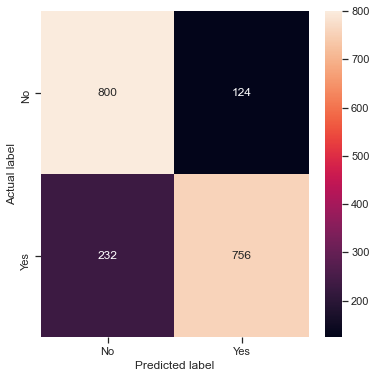

Cross validation result for data 18 is :
0:	learn: 0.6325060	total: 44.6ms	remaining: 8.88s
1:	learn: 0.5984926	total: 97.4ms	remaining: 9.65s
2:	learn: 0.5710843	total: 141ms	remaining: 9.28s
3:	learn: 0.5492065	total: 203ms	remaining: 9.96s
4:	learn: 0.5329928	total: 253ms	remaining: 9.85s
5:	learn: 0.5120673	total: 301ms	remaining: 9.75s
6:	learn: 0.5024404	total: 347ms	remaining: 9.56s
7:	learn: 0.4922331	total: 389ms	remaining: 9.33s
8:	learn: 0.4852335	total: 455ms	remaining: 9.65s
9:	learn: 0.4771550	total: 525ms	remaining: 9.98s
10:	learn: 0.4722389	total: 572ms	remaining: 9.82s
11:	learn: 0.4687045	total: 639ms	remaining: 10s
12:	learn: 0.4650687	total: 703ms	remaining: 10.1s
13:	learn: 0.4609063	total: 760ms	remaining: 10.1s
14:	learn: 0.4586623	total: 823ms	remaining: 10.2s
15:	learn: 0.4560646	total: 876ms	remaining: 10.1s
16:	learn: 0.4541709	total: 947ms	remaining: 10.2s
17:	learn: 0.4518279	total: 1000ms	remaining: 10.1s
18:	learn: 0.4507733	total: 1.06s	remaining: 10.1s

161:	learn: 0.4086445	total: 9.37s	remaining: 2.2s
162:	learn: 0.4082939	total: 9.43s	remaining: 2.14s
163:	learn: 0.4080649	total: 9.49s	remaining: 2.08s
164:	learn: 0.4079920	total: 9.53s	remaining: 2.02s
165:	learn: 0.4076442	total: 9.58s	remaining: 1.96s
166:	learn: 0.4075257	total: 9.65s	remaining: 1.91s
167:	learn: 0.4074188	total: 9.7s	remaining: 1.85s
168:	learn: 0.4073429	total: 9.76s	remaining: 1.79s
169:	learn: 0.4072956	total: 9.83s	remaining: 1.73s
170:	learn: 0.4072542	total: 9.88s	remaining: 1.68s
171:	learn: 0.4071332	total: 9.95s	remaining: 1.62s
172:	learn: 0.4070171	total: 10s	remaining: 1.56s
173:	learn: 0.4068968	total: 10.1s	remaining: 1.5s
174:	learn: 0.4066212	total: 10.1s	remaining: 1.45s
175:	learn: 0.4065259	total: 10.2s	remaining: 1.39s
176:	learn: 0.4064746	total: 10.2s	remaining: 1.33s
177:	learn: 0.4061639	total: 10.3s	remaining: 1.27s
178:	learn: 0.4060280	total: 10.3s	remaining: 1.21s
179:	learn: 0.4059201	total: 10.4s	remaining: 1.15s
180:	learn: 0.405

122:	learn: 0.4135359	total: 6.96s	remaining: 4.36s
123:	learn: 0.4131804	total: 7.02s	remaining: 4.3s
124:	learn: 0.4131690	total: 7.07s	remaining: 4.24s
125:	learn: 0.4130407	total: 7.13s	remaining: 4.18s
126:	learn: 0.4127863	total: 7.18s	remaining: 4.13s
127:	learn: 0.4125417	total: 7.23s	remaining: 4.07s
128:	learn: 0.4121301	total: 7.28s	remaining: 4.01s
129:	learn: 0.4119266	total: 7.34s	remaining: 3.95s
130:	learn: 0.4117584	total: 7.39s	remaining: 3.89s
131:	learn: 0.4115124	total: 7.46s	remaining: 3.85s
132:	learn: 0.4111872	total: 7.52s	remaining: 3.79s
133:	learn: 0.4109728	total: 7.58s	remaining: 3.74s
134:	learn: 0.4107166	total: 7.64s	remaining: 3.68s
135:	learn: 0.4105054	total: 7.72s	remaining: 3.63s
136:	learn: 0.4102552	total: 7.77s	remaining: 3.57s
137:	learn: 0.4100010	total: 7.83s	remaining: 3.52s
138:	learn: 0.4098691	total: 7.89s	remaining: 3.46s
139:	learn: 0.4097489	total: 7.94s	remaining: 3.4s
140:	learn: 0.4097153	total: 7.99s	remaining: 3.34s
141:	learn: 0.

86:	learn: 0.4218194	total: 4.86s	remaining: 6.31s
87:	learn: 0.4211923	total: 4.91s	remaining: 6.25s
88:	learn: 0.4208610	total: 4.97s	remaining: 6.2s
89:	learn: 0.4205532	total: 5.03s	remaining: 6.15s
90:	learn: 0.4204750	total: 5.08s	remaining: 6.08s
91:	learn: 0.4202784	total: 5.13s	remaining: 6.02s
92:	learn: 0.4202076	total: 5.17s	remaining: 5.95s
93:	learn: 0.4200813	total: 5.22s	remaining: 5.88s
94:	learn: 0.4200165	total: 5.3s	remaining: 5.86s
95:	learn: 0.4198429	total: 5.35s	remaining: 5.79s
96:	learn: 0.4198288	total: 5.41s	remaining: 5.74s
97:	learn: 0.4194882	total: 5.48s	remaining: 5.7s
98:	learn: 0.4193098	total: 5.56s	remaining: 5.67s
99:	learn: 0.4191403	total: 5.61s	remaining: 5.61s
100:	learn: 0.4190023	total: 5.68s	remaining: 5.57s
101:	learn: 0.4189582	total: 5.74s	remaining: 5.51s
102:	learn: 0.4186909	total: 5.82s	remaining: 5.48s
103:	learn: 0.4184111	total: 5.88s	remaining: 5.43s
104:	learn: 0.4181239	total: 5.95s	remaining: 5.38s
105:	learn: 0.4174746	total: 

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 19 is : 0.8104391185459224
Train f1_score [No]: for data 19 is : 0.8180906073936869
              precision    recall  f1-score   support

          No       0.78      0.86      0.82       924
         Yes       0.85      0.77      0.81       988

    accuracy                           0.81      1912
   macro avg       0.82      0.81      0.81      1912
weighted avg       0.82      0.81      0.81      1912



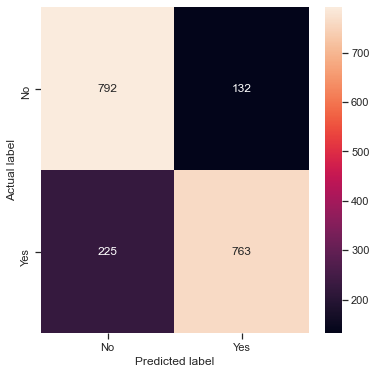

Cross validation result for data 19 is :
0:	learn: 0.6370290	total: 55.6ms	remaining: 11.1s
1:	learn: 0.5911095	total: 112ms	remaining: 11.1s
2:	learn: 0.5634851	total: 176ms	remaining: 11.6s
3:	learn: 0.5424526	total: 219ms	remaining: 10.7s
4:	learn: 0.5245844	total: 294ms	remaining: 11.5s
5:	learn: 0.5117442	total: 348ms	remaining: 11.3s
6:	learn: 0.5017628	total: 396ms	remaining: 10.9s
7:	learn: 0.4938282	total: 455ms	remaining: 10.9s
8:	learn: 0.4856619	total: 524ms	remaining: 11.1s
9:	learn: 0.4766195	total: 572ms	remaining: 10.9s
10:	learn: 0.4727117	total: 640ms	remaining: 11s
11:	learn: 0.4659726	total: 689ms	remaining: 10.8s
12:	learn: 0.4616613	total: 747ms	remaining: 10.7s
13:	learn: 0.4595604	total: 822ms	remaining: 10.9s
14:	learn: 0.4570184	total: 878ms	remaining: 10.8s
15:	learn: 0.4537404	total: 926ms	remaining: 10.6s
16:	learn: 0.4517627	total: 996ms	remaining: 10.7s
17:	learn: 0.4505539	total: 1.06s	remaining: 10.7s
18:	learn: 0.4493603	total: 1.11s	remaining: 10.6s
1

162:	learn: 0.4030552	total: 9.16s	remaining: 2.08s
163:	learn: 0.4028806	total: 9.21s	remaining: 2.02s
164:	learn: 0.4028073	total: 9.27s	remaining: 1.97s
165:	learn: 0.4026818	total: 9.33s	remaining: 1.91s
166:	learn: 0.4025096	total: 9.39s	remaining: 1.85s
167:	learn: 0.4022286	total: 9.46s	remaining: 1.8s
168:	learn: 0.4020995	total: 9.51s	remaining: 1.74s
169:	learn: 0.4019918	total: 9.59s	remaining: 1.69s
170:	learn: 0.4019511	total: 9.65s	remaining: 1.64s
171:	learn: 0.4017739	total: 9.71s	remaining: 1.58s
172:	learn: 0.4014109	total: 9.76s	remaining: 1.52s
173:	learn: 0.4013471	total: 9.82s	remaining: 1.47s
174:	learn: 0.4010616	total: 9.87s	remaining: 1.41s
175:	learn: 0.4008265	total: 9.96s	remaining: 1.36s
176:	learn: 0.4003788	total: 10s	remaining: 1.3s
177:	learn: 0.4001820	total: 10.1s	remaining: 1.25s
178:	learn: 0.4000379	total: 10.2s	remaining: 1.19s
179:	learn: 0.3999769	total: 10.2s	remaining: 1.14s
180:	learn: 0.3997989	total: 10.3s	remaining: 1.08s
181:	learn: 0.39

123:	learn: 0.4116304	total: 6.88s	remaining: 4.22s
124:	learn: 0.4112625	total: 6.94s	remaining: 4.16s
125:	learn: 0.4110267	total: 6.99s	remaining: 4.1s
126:	learn: 0.4106504	total: 7.04s	remaining: 4.05s
127:	learn: 0.4105703	total: 7.09s	remaining: 3.99s
128:	learn: 0.4104581	total: 7.14s	remaining: 3.93s
129:	learn: 0.4101247	total: 7.21s	remaining: 3.88s
130:	learn: 0.4099729	total: 7.27s	remaining: 3.83s
131:	learn: 0.4094222	total: 7.32s	remaining: 3.77s
132:	learn: 0.4092790	total: 7.37s	remaining: 3.71s
133:	learn: 0.4090044	total: 7.42s	remaining: 3.65s
134:	learn: 0.4089599	total: 7.48s	remaining: 3.6s
135:	learn: 0.4087581	total: 7.53s	remaining: 3.54s
136:	learn: 0.4086290	total: 7.58s	remaining: 3.49s
137:	learn: 0.4085375	total: 7.64s	remaining: 3.43s
138:	learn: 0.4080984	total: 7.71s	remaining: 3.38s
139:	learn: 0.4080310	total: 7.77s	remaining: 3.33s
140:	learn: 0.4077787	total: 7.83s	remaining: 3.28s
141:	learn: 0.4072562	total: 7.9s	remaining: 3.23s
142:	learn: 0.4

87:	learn: 0.4259264	total: 4.94s	remaining: 6.29s
88:	learn: 0.4258194	total: 5.01s	remaining: 6.24s
89:	learn: 0.4255446	total: 5.06s	remaining: 6.18s
90:	learn: 0.4254092	total: 5.11s	remaining: 6.12s
91:	learn: 0.4252728	total: 5.18s	remaining: 6.08s
92:	learn: 0.4247487	total: 5.24s	remaining: 6.03s
93:	learn: 0.4244662	total: 5.29s	remaining: 5.97s
94:	learn: 0.4243253	total: 5.34s	remaining: 5.9s
95:	learn: 0.4240551	total: 5.4s	remaining: 5.85s
96:	learn: 0.4238035	total: 5.46s	remaining: 5.8s
97:	learn: 0.4232251	total: 5.51s	remaining: 5.73s
98:	learn: 0.4228466	total: 5.56s	remaining: 5.67s
99:	learn: 0.4225188	total: 5.61s	remaining: 5.61s
100:	learn: 0.4223058	total: 5.67s	remaining: 5.56s
101:	learn: 0.4221638	total: 5.72s	remaining: 5.5s
102:	learn: 0.4218334	total: 5.79s	remaining: 5.45s
103:	learn: 0.4216455	total: 5.84s	remaining: 5.39s
104:	learn: 0.4214558	total: 5.9s	remaining: 5.34s
105:	learn: 0.4212852	total: 5.95s	remaining: 5.27s
106:	learn: 0.4210546	total: 6

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 20 is : 0.8158208243983798
Train f1_score [No]: for data 20 is : 0.818828125
              precision    recall  f1-score   support

          No       0.79      0.85      0.82       924
         Yes       0.85      0.79      0.82       988

    accuracy                           0.82      1912
   macro avg       0.82      0.82      0.82      1912
weighted avg       0.82      0.82      0.82      1912



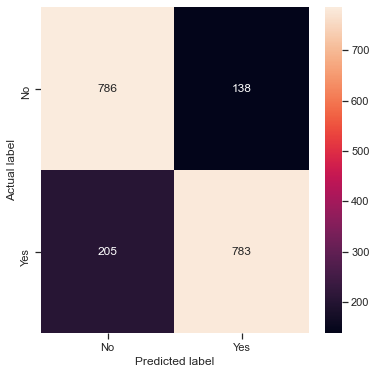

Cross validation result for data 20 is :
0:	learn: 0.6417501	total: 43.4ms	remaining: 8.63s
1:	learn: 0.5949471	total: 86.9ms	remaining: 8.6s
2:	learn: 0.5665169	total: 136ms	remaining: 8.9s
3:	learn: 0.5399548	total: 178ms	remaining: 8.7s
4:	learn: 0.5229349	total: 236ms	remaining: 9.19s
5:	learn: 0.5092728	total: 311ms	remaining: 10.1s
6:	learn: 0.4977748	total: 376ms	remaining: 10.4s
7:	learn: 0.4901223	total: 458ms	remaining: 11s
8:	learn: 0.4832040	total: 508ms	remaining: 10.8s
9:	learn: 0.4747515	total: 562ms	remaining: 10.7s
10:	learn: 0.4692340	total: 613ms	remaining: 10.5s
11:	learn: 0.4632639	total: 682ms	remaining: 10.7s
12:	learn: 0.4597641	total: 738ms	remaining: 10.6s
13:	learn: 0.4572380	total: 807ms	remaining: 10.7s
14:	learn: 0.4549535	total: 853ms	remaining: 10.5s
15:	learn: 0.4531119	total: 911ms	remaining: 10.5s
16:	learn: 0.4514119	total: 966ms	remaining: 10.4s
17:	learn: 0.4498733	total: 1.01s	remaining: 10.3s
18:	learn: 0.4484800	total: 1.08s	remaining: 10.3s
19:

163:	learn: 0.4006884	total: 9.25s	remaining: 2.03s
164:	learn: 0.4005346	total: 9.31s	remaining: 1.98s
165:	learn: 0.4003169	total: 9.37s	remaining: 1.92s
166:	learn: 0.4001827	total: 9.41s	remaining: 1.86s
167:	learn: 0.4000836	total: 9.46s	remaining: 1.8s
168:	learn: 0.3999620	total: 9.51s	remaining: 1.74s
169:	learn: 0.3997614	total: 9.57s	remaining: 1.69s
170:	learn: 0.3996621	total: 9.62s	remaining: 1.63s
171:	learn: 0.3991282	total: 9.66s	remaining: 1.57s
172:	learn: 0.3987414	total: 9.73s	remaining: 1.52s
173:	learn: 0.3986658	total: 9.79s	remaining: 1.46s
174:	learn: 0.3985388	total: 9.84s	remaining: 1.41s
175:	learn: 0.3983094	total: 9.91s	remaining: 1.35s
176:	learn: 0.3981651	total: 9.96s	remaining: 1.29s
177:	learn: 0.3979275	total: 10s	remaining: 1.24s
178:	learn: 0.3978464	total: 10.1s	remaining: 1.18s
179:	learn: 0.3976702	total: 10.1s	remaining: 1.13s
180:	learn: 0.3973762	total: 10.2s	remaining: 1.07s
181:	learn: 0.3972133	total: 10.2s	remaining: 1.01s
182:	learn: 0.3

124:	learn: 0.4136529	total: 6.67s	remaining: 4s
125:	learn: 0.4136381	total: 6.72s	remaining: 3.95s
126:	learn: 0.4133463	total: 6.81s	remaining: 3.91s
127:	learn: 0.4133289	total: 6.86s	remaining: 3.86s
128:	learn: 0.4130076	total: 6.91s	remaining: 3.8s
129:	learn: 0.4123055	total: 6.98s	remaining: 3.76s
130:	learn: 0.4121255	total: 7.04s	remaining: 3.71s
131:	learn: 0.4119193	total: 7.09s	remaining: 3.65s
132:	learn: 0.4117932	total: 7.14s	remaining: 3.6s
133:	learn: 0.4115559	total: 7.18s	remaining: 3.54s
134:	learn: 0.4115477	total: 7.24s	remaining: 3.48s
135:	learn: 0.4114350	total: 7.3s	remaining: 3.44s
136:	learn: 0.4108912	total: 7.35s	remaining: 3.38s
137:	learn: 0.4107933	total: 7.41s	remaining: 3.33s
138:	learn: 0.4107619	total: 7.45s	remaining: 3.27s
139:	learn: 0.4105626	total: 7.5s	remaining: 3.21s
140:	learn: 0.4105324	total: 7.56s	remaining: 3.16s
141:	learn: 0.4103878	total: 7.64s	remaining: 3.12s
142:	learn: 0.4101764	total: 7.7s	remaining: 3.07s
143:	learn: 0.410029

87:	learn: 0.4160886	total: 4.77s	remaining: 6.07s
88:	learn: 0.4157112	total: 4.82s	remaining: 6.01s
89:	learn: 0.4156651	total: 4.86s	remaining: 5.94s
90:	learn: 0.4153816	total: 4.92s	remaining: 5.89s
91:	learn: 0.4152969	total: 4.98s	remaining: 5.85s
92:	learn: 0.4152505	total: 5.02s	remaining: 5.78s
93:	learn: 0.4151874	total: 5.06s	remaining: 5.71s
94:	learn: 0.4146076	total: 5.11s	remaining: 5.65s
95:	learn: 0.4139361	total: 5.17s	remaining: 5.61s
96:	learn: 0.4137032	total: 5.23s	remaining: 5.55s
97:	learn: 0.4134206	total: 5.28s	remaining: 5.5s
98:	learn: 0.4132942	total: 5.35s	remaining: 5.46s
99:	learn: 0.4126052	total: 5.41s	remaining: 5.41s
100:	learn: 0.4123202	total: 5.49s	remaining: 5.38s
101:	learn: 0.4120045	total: 5.55s	remaining: 5.33s
102:	learn: 0.4118722	total: 5.61s	remaining: 5.28s
103:	learn: 0.4118416	total: 5.66s	remaining: 5.22s
104:	learn: 0.4112032	total: 5.73s	remaining: 5.19s
105:	learn: 0.4110816	total: 5.8s	remaining: 5.14s
106:	learn: 0.4105729	total

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 21 is : 0.8066174108576935
Train f1_score [No]: for data 21 is : 0.8138959734137106
              precision    recall  f1-score   support

          No       0.77      0.84      0.80       924
         Yes       0.83      0.77      0.80       988

    accuracy                           0.80      1912
   macro avg       0.80      0.80      0.80      1912
weighted avg       0.80      0.80      0.80      1912



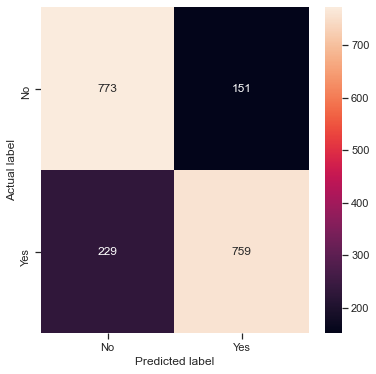

Cross validation result for data 21 is :
0:	learn: 0.6372850	total: 49.1ms	remaining: 9.77s
1:	learn: 0.6028661	total: 94ms	remaining: 9.3s
2:	learn: 0.5675498	total: 144ms	remaining: 9.47s
3:	learn: 0.5465776	total: 203ms	remaining: 9.94s
4:	learn: 0.5313832	total: 246ms	remaining: 9.6s
5:	learn: 0.5132109	total: 292ms	remaining: 9.44s
6:	learn: 0.5016946	total: 338ms	remaining: 9.31s
7:	learn: 0.4940921	total: 386ms	remaining: 9.26s
8:	learn: 0.4871399	total: 446ms	remaining: 9.46s
9:	learn: 0.4825138	total: 496ms	remaining: 9.41s
10:	learn: 0.4776284	total: 544ms	remaining: 9.34s
11:	learn: 0.4742271	total: 595ms	remaining: 9.33s
12:	learn: 0.4704802	total: 642ms	remaining: 9.23s
13:	learn: 0.4674713	total: 697ms	remaining: 9.26s
14:	learn: 0.4645347	total: 746ms	remaining: 9.2s
15:	learn: 0.4622758	total: 798ms	remaining: 9.17s
16:	learn: 0.4610264	total: 861ms	remaining: 9.27s
17:	learn: 0.4598269	total: 931ms	remaining: 9.41s
18:	learn: 0.4589011	total: 958ms	remaining: 9.12s
19:

162:	learn: 0.4110962	total: 9.28s	remaining: 2.11s
163:	learn: 0.4109903	total: 9.36s	remaining: 2.05s
164:	learn: 0.4107463	total: 9.5s	remaining: 2.02s
165:	learn: 0.4106270	total: 9.6s	remaining: 1.97s
166:	learn: 0.4103833	total: 9.67s	remaining: 1.91s
167:	learn: 0.4102480	total: 9.74s	remaining: 1.85s
168:	learn: 0.4097496	total: 9.81s	remaining: 1.8s
169:	learn: 0.4095233	total: 9.87s	remaining: 1.74s
170:	learn: 0.4090836	total: 9.95s	remaining: 1.69s
171:	learn: 0.4088046	total: 10s	remaining: 1.63s
172:	learn: 0.4085971	total: 10.2s	remaining: 1.58s
173:	learn: 0.4085414	total: 10.3s	remaining: 1.54s
174:	learn: 0.4083861	total: 10.3s	remaining: 1.48s
175:	learn: 0.4082478	total: 10.4s	remaining: 1.42s
176:	learn: 0.4079942	total: 10.4s	remaining: 1.36s
177:	learn: 0.4079019	total: 10.5s	remaining: 1.29s
178:	learn: 0.4078395	total: 10.5s	remaining: 1.24s
179:	learn: 0.4077114	total: 10.6s	remaining: 1.18s
180:	learn: 0.4075521	total: 10.6s	remaining: 1.12s
181:	learn: 0.407

123:	learn: 0.4182450	total: 6.66s	remaining: 4.08s
124:	learn: 0.4174871	total: 6.72s	remaining: 4.03s
125:	learn: 0.4173315	total: 6.76s	remaining: 3.97s
126:	learn: 0.4168856	total: 6.81s	remaining: 3.91s
127:	learn: 0.4168607	total: 6.87s	remaining: 3.86s
128:	learn: 0.4163886	total: 6.92s	remaining: 3.81s
129:	learn: 0.4162592	total: 6.97s	remaining: 3.75s
130:	learn: 0.4160873	total: 7.01s	remaining: 3.69s
131:	learn: 0.4160251	total: 7.06s	remaining: 3.64s
132:	learn: 0.4156575	total: 7.11s	remaining: 3.58s
133:	learn: 0.4155624	total: 7.16s	remaining: 3.53s
134:	learn: 0.4153558	total: 7.21s	remaining: 3.47s
135:	learn: 0.4151836	total: 7.26s	remaining: 3.42s
136:	learn: 0.4146036	total: 7.31s	remaining: 3.36s
137:	learn: 0.4144913	total: 7.36s	remaining: 3.31s
138:	learn: 0.4144763	total: 7.43s	remaining: 3.26s
139:	learn: 0.4142904	total: 7.49s	remaining: 3.21s
140:	learn: 0.4142356	total: 7.53s	remaining: 3.15s
141:	learn: 0.4139840	total: 7.58s	remaining: 3.1s
142:	learn: 0

86:	learn: 0.4247176	total: 4.73s	remaining: 6.14s
87:	learn: 0.4242939	total: 4.77s	remaining: 6.08s
88:	learn: 0.4239422	total: 4.83s	remaining: 6.02s
89:	learn: 0.4238028	total: 4.88s	remaining: 5.97s
90:	learn: 0.4234700	total: 4.93s	remaining: 5.91s
91:	learn: 0.4233366	total: 4.99s	remaining: 5.85s
92:	learn: 0.4230675	total: 5.05s	remaining: 5.81s
93:	learn: 0.4228489	total: 5.12s	remaining: 5.77s
94:	learn: 0.4226864	total: 5.17s	remaining: 5.71s
95:	learn: 0.4225573	total: 5.22s	remaining: 5.65s
96:	learn: 0.4223821	total: 5.27s	remaining: 5.6s
97:	learn: 0.4219086	total: 5.33s	remaining: 5.54s
98:	learn: 0.4215501	total: 5.38s	remaining: 5.49s
99:	learn: 0.4204771	total: 5.47s	remaining: 5.47s
100:	learn: 0.4202973	total: 5.53s	remaining: 5.42s
101:	learn: 0.4201454	total: 5.59s	remaining: 5.37s
102:	learn: 0.4198831	total: 5.63s	remaining: 5.3s
103:	learn: 0.4198134	total: 5.68s	remaining: 5.25s
104:	learn: 0.4196793	total: 5.74s	remaining: 5.2s
105:	learn: 0.4195261	total: 

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 22 is : 0.8100491182864966
Train f1_score [No]: for data 22 is : 0.8181467776749923
              precision    recall  f1-score   support

          No       0.76      0.84      0.80       924
         Yes       0.83      0.75      0.79       988

    accuracy                           0.79      1912
   macro avg       0.80      0.80      0.79      1912
weighted avg       0.80      0.79      0.79      1912



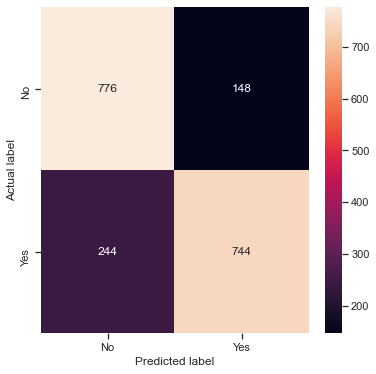

Cross validation result for data 22 is :
0:	learn: 0.6356882	total: 45ms	remaining: 8.96s
1:	learn: 0.5919519	total: 94.3ms	remaining: 9.34s
2:	learn: 0.5626590	total: 134ms	remaining: 8.83s
3:	learn: 0.5484770	total: 156ms	remaining: 7.64s
4:	learn: 0.5280543	total: 211ms	remaining: 8.24s
5:	learn: 0.5123858	total: 261ms	remaining: 8.45s
6:	learn: 0.5017781	total: 306ms	remaining: 8.42s
7:	learn: 0.4908892	total: 388ms	remaining: 9.32s
8:	learn: 0.4833792	total: 445ms	remaining: 9.45s
9:	learn: 0.4772203	total: 536ms	remaining: 10.2s
10:	learn: 0.4729327	total: 582ms	remaining: 10s
11:	learn: 0.4684572	total: 632ms	remaining: 9.91s
12:	learn: 0.4649576	total: 710ms	remaining: 10.2s
13:	learn: 0.4619687	total: 780ms	remaining: 10.4s
14:	learn: 0.4600280	total: 829ms	remaining: 10.2s
15:	learn: 0.4577388	total: 879ms	remaining: 10.1s
16:	learn: 0.4556227	total: 930ms	remaining: 10s
17:	learn: 0.4540061	total: 973ms	remaining: 9.84s
18:	learn: 0.4524117	total: 1.02s	remaining: 9.76s
19:	

163:	learn: 0.4039196	total: 8.86s	remaining: 1.95s
164:	learn: 0.4037629	total: 8.9s	remaining: 1.89s
165:	learn: 0.4037028	total: 8.96s	remaining: 1.84s
166:	learn: 0.4033462	total: 9.03s	remaining: 1.78s
167:	learn: 0.4032219	total: 9.09s	remaining: 1.73s
168:	learn: 0.4030835	total: 9.14s	remaining: 1.68s
169:	learn: 0.4028153	total: 9.2s	remaining: 1.62s
170:	learn: 0.4027805	total: 9.25s	remaining: 1.57s
171:	learn: 0.4026966	total: 9.31s	remaining: 1.52s
172:	learn: 0.4024884	total: 9.37s	remaining: 1.46s
173:	learn: 0.4023543	total: 9.41s	remaining: 1.41s
174:	learn: 0.4022908	total: 9.46s	remaining: 1.35s
175:	learn: 0.4021079	total: 9.51s	remaining: 1.3s
176:	learn: 0.4019281	total: 9.56s	remaining: 1.24s
177:	learn: 0.4017551	total: 9.61s	remaining: 1.19s
178:	learn: 0.4016582	total: 9.67s	remaining: 1.13s
179:	learn: 0.4014487	total: 9.74s	remaining: 1.08s
180:	learn: 0.4013730	total: 9.83s	remaining: 1.03s
181:	learn: 0.4012291	total: 9.88s	remaining: 977ms
182:	learn: 0.4

124:	learn: 0.4134326	total: 7.18s	remaining: 4.31s
125:	learn: 0.4133009	total: 7.23s	remaining: 4.25s
126:	learn: 0.4131102	total: 7.3s	remaining: 4.19s
127:	learn: 0.4128730	total: 7.36s	remaining: 4.14s
128:	learn: 0.4126944	total: 7.45s	remaining: 4.1s
129:	learn: 0.4122785	total: 7.5s	remaining: 4.04s
130:	learn: 0.4118637	total: 7.57s	remaining: 3.99s
131:	learn: 0.4115742	total: 7.62s	remaining: 3.92s
132:	learn: 0.4113541	total: 7.67s	remaining: 3.86s
133:	learn: 0.4111176	total: 7.72s	remaining: 3.8s
134:	learn: 0.4109206	total: 7.81s	remaining: 3.76s
135:	learn: 0.4106157	total: 7.86s	remaining: 3.7s
136:	learn: 0.4104848	total: 7.92s	remaining: 3.64s
137:	learn: 0.4102716	total: 7.97s	remaining: 3.58s
138:	learn: 0.4101801	total: 8.03s	remaining: 3.52s
139:	learn: 0.4099110	total: 8.09s	remaining: 3.46s
140:	learn: 0.4097871	total: 8.16s	remaining: 3.41s
141:	learn: 0.4096803	total: 8.22s	remaining: 3.36s
142:	learn: 0.4095943	total: 8.26s	remaining: 3.29s
143:	learn: 0.409

86:	learn: 0.4230720	total: 4.75s	remaining: 6.17s
87:	learn: 0.4226653	total: 4.81s	remaining: 6.12s
88:	learn: 0.4224612	total: 4.86s	remaining: 6.07s
89:	learn: 0.4221762	total: 4.92s	remaining: 6.01s
90:	learn: 0.4221707	total: 4.95s	remaining: 5.92s
91:	learn: 0.4221707	total: 4.96s	remaining: 5.83s
92:	learn: 0.4216516	total: 5.01s	remaining: 5.76s
93:	learn: 0.4216445	total: 5.05s	remaining: 5.69s
94:	learn: 0.4215384	total: 5.1s	remaining: 5.63s
95:	learn: 0.4212591	total: 5.16s	remaining: 5.58s
96:	learn: 0.4211636	total: 5.22s	remaining: 5.54s
97:	learn: 0.4207392	total: 5.32s	remaining: 5.54s
98:	learn: 0.4204642	total: 5.37s	remaining: 5.48s
99:	learn: 0.4204642	total: 5.39s	remaining: 5.39s
100:	learn: 0.4200808	total: 5.43s	remaining: 5.33s
101:	learn: 0.4193336	total: 5.51s	remaining: 5.3s
102:	learn: 0.4192434	total: 5.58s	remaining: 5.25s
103:	learn: 0.4187706	total: 5.64s	remaining: 5.21s
104:	learn: 0.4186595	total: 5.71s	remaining: 5.16s
105:	learn: 0.4185506	total:

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 23 is : 0.8065959762931902
Train f1_score [No]: for data 23 is : 0.8153366439542672
              precision    recall  f1-score   support

          No       0.76      0.85      0.80       924
         Yes       0.84      0.74      0.79       988

    accuracy                           0.79      1912
   macro avg       0.80      0.80      0.79      1912
weighted avg       0.80      0.79      0.79      1912



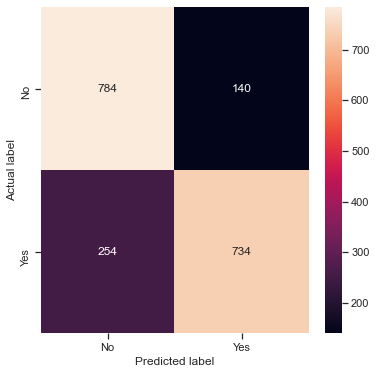

Cross validation result for data 23 is :
0:	learn: 0.6322199	total: 45.9ms	remaining: 9.14s
1:	learn: 0.6003250	total: 86.4ms	remaining: 8.56s
2:	learn: 0.5737306	total: 129ms	remaining: 8.45s
3:	learn: 0.5456601	total: 176ms	remaining: 8.61s
4:	learn: 0.5257689	total: 217ms	remaining: 8.48s
5:	learn: 0.5136626	total: 277ms	remaining: 8.95s
6:	learn: 0.5047101	total: 324ms	remaining: 8.93s
7:	learn: 0.4947246	total: 379ms	remaining: 9.1s
8:	learn: 0.4869990	total: 445ms	remaining: 9.44s
9:	learn: 0.4799909	total: 505ms	remaining: 9.6s
10:	learn: 0.4755602	total: 584ms	remaining: 10s
11:	learn: 0.4715611	total: 637ms	remaining: 9.97s
12:	learn: 0.4686222	total: 709ms	remaining: 10.2s
13:	learn: 0.4653039	total: 758ms	remaining: 10.1s
14:	learn: 0.4629648	total: 815ms	remaining: 10.1s
15:	learn: 0.4601489	total: 885ms	remaining: 10.2s
16:	learn: 0.4587641	total: 929ms	remaining: 10s
17:	learn: 0.4576621	total: 983ms	remaining: 9.94s
18:	learn: 0.4560659	total: 1.05s	remaining: 10s
19:	le

162:	learn: 0.4115441	total: 8.73s	remaining: 1.98s
163:	learn: 0.4115409	total: 8.77s	remaining: 1.93s
164:	learn: 0.4112603	total: 8.84s	remaining: 1.88s
165:	learn: 0.4110552	total: 8.9s	remaining: 1.82s
166:	learn: 0.4108728	total: 8.95s	remaining: 1.77s
167:	learn: 0.4106070	total: 9.01s	remaining: 1.72s
168:	learn: 0.4105414	total: 9.06s	remaining: 1.66s
169:	learn: 0.4102638	total: 9.12s	remaining: 1.61s
170:	learn: 0.4100647	total: 9.16s	remaining: 1.55s
171:	learn: 0.4099877	total: 9.23s	remaining: 1.5s
172:	learn: 0.4099535	total: 9.29s	remaining: 1.45s
173:	learn: 0.4097836	total: 9.35s	remaining: 1.4s
174:	learn: 0.4096261	total: 9.4s	remaining: 1.34s
175:	learn: 0.4092773	total: 9.46s	remaining: 1.29s
176:	learn: 0.4092183	total: 9.52s	remaining: 1.24s
177:	learn: 0.4088311	total: 9.6s	remaining: 1.19s
178:	learn: 0.4087040	total: 9.66s	remaining: 1.13s
179:	learn: 0.4083615	total: 9.72s	remaining: 1.08s
180:	learn: 0.4081225	total: 9.77s	remaining: 1.02s
181:	learn: 0.408

125:	learn: 0.4153363	total: 6.53s	remaining: 3.84s
126:	learn: 0.4149029	total: 6.6s	remaining: 3.8s
127:	learn: 0.4143509	total: 6.66s	remaining: 3.74s
128:	learn: 0.4141291	total: 6.72s	remaining: 3.7s
129:	learn: 0.4135181	total: 6.77s	remaining: 3.64s
130:	learn: 0.4130972	total: 6.84s	remaining: 3.6s
131:	learn: 0.4129170	total: 6.89s	remaining: 3.55s
132:	learn: 0.4129169	total: 6.95s	remaining: 3.5s
133:	learn: 0.4127859	total: 7s	remaining: 3.44s
134:	learn: 0.4126970	total: 7.04s	remaining: 3.39s
135:	learn: 0.4124989	total: 7.09s	remaining: 3.34s
136:	learn: 0.4123669	total: 7.15s	remaining: 3.29s
137:	learn: 0.4123657	total: 7.2s	remaining: 3.23s
138:	learn: 0.4122957	total: 7.25s	remaining: 3.18s
139:	learn: 0.4120011	total: 7.29s	remaining: 3.13s
140:	learn: 0.4118622	total: 7.36s	remaining: 3.08s
141:	learn: 0.4117078	total: 7.4s	remaining: 3.02s
142:	learn: 0.4113660	total: 7.45s	remaining: 2.97s
143:	learn: 0.4111527	total: 7.5s	remaining: 2.92s
144:	learn: 0.4106904	t

88:	learn: 0.4288079	total: 4.73s	remaining: 5.9s
89:	learn: 0.4283151	total: 4.78s	remaining: 5.84s
90:	learn: 0.4277179	total: 4.83s	remaining: 5.79s
91:	learn: 0.4275225	total: 4.89s	remaining: 5.75s
92:	learn: 0.4272165	total: 4.94s	remaining: 5.69s
93:	learn: 0.4267097	total: 5.01s	remaining: 5.65s
94:	learn: 0.4265591	total: 5.06s	remaining: 5.59s
95:	learn: 0.4261232	total: 5.13s	remaining: 5.56s
96:	learn: 0.4257390	total: 5.18s	remaining: 5.5s
97:	learn: 0.4251551	total: 5.23s	remaining: 5.44s
98:	learn: 0.4249640	total: 5.29s	remaining: 5.4s
99:	learn: 0.4249158	total: 5.35s	remaining: 5.35s
100:	learn: 0.4247138	total: 5.42s	remaining: 5.31s
101:	learn: 0.4244729	total: 5.48s	remaining: 5.26s
102:	learn: 0.4242733	total: 5.54s	remaining: 5.21s
103:	learn: 0.4242405	total: 5.59s	remaining: 5.17s
104:	learn: 0.4240043	total: 5.64s	remaining: 5.11s
105:	learn: 0.4238034	total: 5.69s	remaining: 5.04s
106:	learn: 0.4238034	total: 5.71s	remaining: 4.97s
107:	learn: 0.4237237	total

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 24 is : 0.8176615531356808
Train f1_score [No]: for data 24 is : 0.8209071746428294
              precision    recall  f1-score   support

          No       0.77      0.83      0.80       924
         Yes       0.83      0.77      0.80       988

    accuracy                           0.80      1912
   macro avg       0.80      0.80      0.80      1912
weighted avg       0.80      0.80      0.80      1912



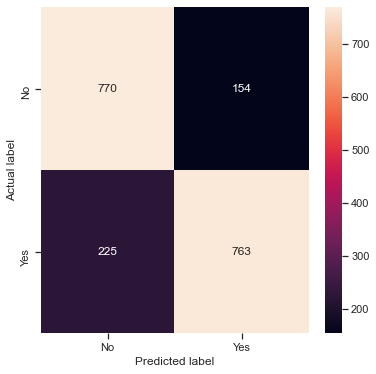

Cross validation result for data 24 is :
0:	learn: 0.6324456	total: 58.3ms	remaining: 11.6s
1:	learn: 0.5913309	total: 123ms	remaining: 12.2s
2:	learn: 0.5613757	total: 172ms	remaining: 11.3s
3:	learn: 0.5430441	total: 238ms	remaining: 11.7s
4:	learn: 0.5242621	total: 291ms	remaining: 11.3s
5:	learn: 0.5112702	total: 343ms	remaining: 11.1s
6:	learn: 0.5023403	total: 390ms	remaining: 10.8s
7:	learn: 0.4927482	total: 453ms	remaining: 10.9s
8:	learn: 0.4849057	total: 531ms	remaining: 11.3s
9:	learn: 0.4776414	total: 600ms	remaining: 11.4s
10:	learn: 0.4735294	total: 659ms	remaining: 11.3s
11:	learn: 0.4695328	total: 719ms	remaining: 11.3s
12:	learn: 0.4648023	total: 787ms	remaining: 11.3s
13:	learn: 0.4622429	total: 836ms	remaining: 11.1s
14:	learn: 0.4601501	total: 938ms	remaining: 11.6s
15:	learn: 0.4579241	total: 1.02s	remaining: 11.7s
16:	learn: 0.4555319	total: 1.09s	remaining: 11.7s
17:	learn: 0.4540118	total: 1.14s	remaining: 11.5s
18:	learn: 0.4524907	total: 1.19s	remaining: 11.3s

161:	learn: 0.4044710	total: 9.25s	remaining: 2.17s
162:	learn: 0.4042403	total: 9.32s	remaining: 2.12s
163:	learn: 0.4040463	total: 9.39s	remaining: 2.06s
164:	learn: 0.4038593	total: 9.45s	remaining: 2s
165:	learn: 0.4037669	total: 9.5s	remaining: 1.95s
166:	learn: 0.4034521	total: 9.55s	remaining: 1.89s
167:	learn: 0.4032591	total: 9.61s	remaining: 1.83s
168:	learn: 0.4030021	total: 9.68s	remaining: 1.77s
169:	learn: 0.4026907	total: 9.72s	remaining: 1.72s
170:	learn: 0.4025225	total: 9.78s	remaining: 1.66s
171:	learn: 0.4022588	total: 9.84s	remaining: 1.6s
172:	learn: 0.4021554	total: 9.92s	remaining: 1.55s
173:	learn: 0.4020973	total: 9.98s	remaining: 1.49s
174:	learn: 0.4018170	total: 10s	remaining: 1.44s
175:	learn: 0.4017336	total: 10.1s	remaining: 1.38s
176:	learn: 0.4014076	total: 10.2s	remaining: 1.32s
177:	learn: 0.4010748	total: 10.2s	remaining: 1.27s
178:	learn: 0.4006525	total: 10.3s	remaining: 1.21s
179:	learn: 0.4004824	total: 10.4s	remaining: 1.15s
180:	learn: 0.40040

122:	learn: 0.4098010	total: 6.58s	remaining: 4.12s
123:	learn: 0.4096338	total: 6.63s	remaining: 4.07s
124:	learn: 0.4096140	total: 6.7s	remaining: 4.02s
125:	learn: 0.4093245	total: 6.78s	remaining: 3.98s
126:	learn: 0.4088161	total: 6.84s	remaining: 3.93s
127:	learn: 0.4087948	total: 6.89s	remaining: 3.88s
128:	learn: 0.4086432	total: 6.94s	remaining: 3.82s
129:	learn: 0.4084804	total: 6.99s	remaining: 3.76s
130:	learn: 0.4081995	total: 7.05s	remaining: 3.71s
131:	learn: 0.4081507	total: 7.1s	remaining: 3.66s
132:	learn: 0.4080117	total: 7.16s	remaining: 3.6s
133:	learn: 0.4077409	total: 7.22s	remaining: 3.55s
134:	learn: 0.4073535	total: 7.27s	remaining: 3.5s
135:	learn: 0.4072965	total: 7.32s	remaining: 3.44s
136:	learn: 0.4071990	total: 7.37s	remaining: 3.39s
137:	learn: 0.4070277	total: 7.42s	remaining: 3.33s
138:	learn: 0.4070005	total: 7.47s	remaining: 3.28s
139:	learn: 0.4068610	total: 7.53s	remaining: 3.23s
140:	learn: 0.4065498	total: 7.58s	remaining: 3.17s
141:	learn: 0.40

86:	learn: 0.4185569	total: 4.49s	remaining: 5.83s
87:	learn: 0.4184666	total: 4.54s	remaining: 5.78s
88:	learn: 0.4182886	total: 4.58s	remaining: 5.72s
89:	learn: 0.4180830	total: 4.63s	remaining: 5.66s
90:	learn: 0.4177857	total: 4.68s	remaining: 5.6s
91:	learn: 0.4176970	total: 4.74s	remaining: 5.56s
92:	learn: 0.4173422	total: 4.8s	remaining: 5.52s
93:	learn: 0.4172243	total: 4.84s	remaining: 5.46s
94:	learn: 0.4172237	total: 4.86s	remaining: 5.37s
95:	learn: 0.4170564	total: 4.9s	remaining: 5.31s
96:	learn: 0.4167711	total: 4.95s	remaining: 5.26s
97:	learn: 0.4166688	total: 5.02s	remaining: 5.22s
98:	learn: 0.4164868	total: 5.07s	remaining: 5.17s
99:	learn: 0.4163934	total: 5.12s	remaining: 5.12s
100:	learn: 0.4159128	total: 5.16s	remaining: 5.06s
101:	learn: 0.4152351	total: 5.22s	remaining: 5.02s
102:	learn: 0.4149873	total: 5.28s	remaining: 4.97s
103:	learn: 0.4141851	total: 5.33s	remaining: 4.92s
104:	learn: 0.4140068	total: 5.38s	remaining: 4.87s
105:	learn: 0.4137974	total: 

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 25 is : 0.8112870579830933
Train f1_score [No]: for data 25 is : 0.81413438611578
              precision    recall  f1-score   support

          No       0.78      0.87      0.82       924
         Yes       0.86      0.77      0.81       988

    accuracy                           0.82      1912
   macro avg       0.82      0.82      0.82      1912
weighted avg       0.82      0.82      0.82      1912



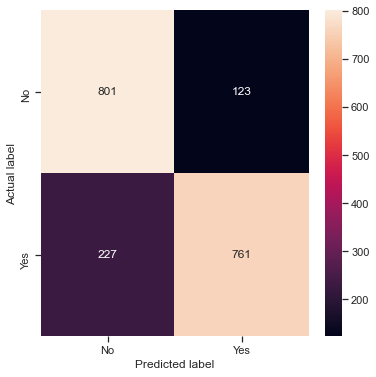

Cross validation result for data 25 is :
0:	learn: 0.6316573	total: 53.9ms	remaining: 10.7s
1:	learn: 0.5942668	total: 99.3ms	remaining: 9.84s
2:	learn: 0.5649839	total: 147ms	remaining: 9.67s
3:	learn: 0.5428656	total: 197ms	remaining: 9.67s
4:	learn: 0.5232532	total: 239ms	remaining: 9.31s
5:	learn: 0.5113147	total: 289ms	remaining: 9.35s
6:	learn: 0.5023456	total: 334ms	remaining: 9.22s
7:	learn: 0.4920267	total: 384ms	remaining: 9.21s
8:	learn: 0.4849080	total: 428ms	remaining: 9.09s
9:	learn: 0.4758738	total: 487ms	remaining: 9.25s
10:	learn: 0.4722546	total: 540ms	remaining: 9.27s
11:	learn: 0.4689395	total: 589ms	remaining: 9.22s
12:	learn: 0.4659516	total: 649ms	remaining: 9.33s
13:	learn: 0.4633729	total: 701ms	remaining: 9.31s
14:	learn: 0.4597313	total: 759ms	remaining: 9.36s
15:	learn: 0.4578472	total: 822ms	remaining: 9.45s
16:	learn: 0.4553734	total: 888ms	remaining: 9.56s
17:	learn: 0.4538978	total: 934ms	remaining: 9.45s
18:	learn: 0.4524270	total: 981ms	remaining: 9.35

162:	learn: 0.4059875	total: 8.89s	remaining: 2.02s
163:	learn: 0.4059203	total: 8.93s	remaining: 1.96s
164:	learn: 0.4057526	total: 8.99s	remaining: 1.91s
165:	learn: 0.4056964	total: 9.04s	remaining: 1.85s
166:	learn: 0.4056043	total: 9.11s	remaining: 1.8s
167:	learn: 0.4055350	total: 9.15s	remaining: 1.74s
168:	learn: 0.4054456	total: 9.21s	remaining: 1.69s
169:	learn: 0.4052992	total: 9.28s	remaining: 1.64s
170:	learn: 0.4050738	total: 9.34s	remaining: 1.58s
171:	learn: 0.4050419	total: 9.38s	remaining: 1.53s
172:	learn: 0.4049845	total: 9.43s	remaining: 1.47s
173:	learn: 0.4048685	total: 9.49s	remaining: 1.42s
174:	learn: 0.4045367	total: 9.54s	remaining: 1.36s
175:	learn: 0.4044322	total: 9.59s	remaining: 1.31s
176:	learn: 0.4041809	total: 9.65s	remaining: 1.25s
177:	learn: 0.4041200	total: 9.72s	remaining: 1.2s
178:	learn: 0.4039359	total: 9.79s	remaining: 1.15s
179:	learn: 0.4038972	total: 9.84s	remaining: 1.09s
180:	learn: 0.4036605	total: 9.89s	remaining: 1.04s
181:	learn: 0.

126:	learn: 0.4126788	total: 7.16s	remaining: 4.12s
127:	learn: 0.4125674	total: 7.21s	remaining: 4.06s
128:	learn: 0.4125016	total: 7.28s	remaining: 4.01s
129:	learn: 0.4123720	total: 7.35s	remaining: 3.96s
130:	learn: 0.4122245	total: 7.4s	remaining: 3.9s
131:	learn: 0.4118950	total: 7.46s	remaining: 3.84s
132:	learn: 0.4117147	total: 7.52s	remaining: 3.79s
133:	learn: 0.4112111	total: 7.56s	remaining: 3.72s
134:	learn: 0.4110651	total: 7.61s	remaining: 3.66s
135:	learn: 0.4108283	total: 7.66s	remaining: 3.6s
136:	learn: 0.4106865	total: 7.71s	remaining: 3.54s
137:	learn: 0.4105494	total: 7.78s	remaining: 3.49s
138:	learn: 0.4105450	total: 7.82s	remaining: 3.43s
139:	learn: 0.4103855	total: 7.88s	remaining: 3.38s
140:	learn: 0.4101333	total: 7.93s	remaining: 3.32s
141:	learn: 0.4098053	total: 7.98s	remaining: 3.26s
142:	learn: 0.4097352	total: 8.04s	remaining: 3.21s
143:	learn: 0.4095114	total: 8.1s	remaining: 3.15s
144:	learn: 0.4094133	total: 8.17s	remaining: 3.1s
145:	learn: 0.409

91:	learn: 0.4207318	total: 5.05s	remaining: 5.93s
92:	learn: 0.4206147	total: 5.09s	remaining: 5.86s
93:	learn: 0.4204282	total: 5.14s	remaining: 5.8s
94:	learn: 0.4203568	total: 5.2s	remaining: 5.74s
95:	learn: 0.4200264	total: 5.26s	remaining: 5.7s
96:	learn: 0.4198555	total: 5.31s	remaining: 5.64s
97:	learn: 0.4195691	total: 5.38s	remaining: 5.6s
98:	learn: 0.4191059	total: 5.45s	remaining: 5.56s
99:	learn: 0.4190176	total: 5.5s	remaining: 5.5s
100:	learn: 0.4187752	total: 5.57s	remaining: 5.45s
101:	learn: 0.4185359	total: 5.65s	remaining: 5.43s
102:	learn: 0.4182527	total: 5.7s	remaining: 5.37s
103:	learn: 0.4178470	total: 5.75s	remaining: 5.31s
104:	learn: 0.4177670	total: 5.82s	remaining: 5.26s
105:	learn: 0.4176737	total: 5.86s	remaining: 5.2s
106:	learn: 0.4175274	total: 5.93s	remaining: 5.16s
107:	learn: 0.4173160	total: 5.99s	remaining: 5.11s
108:	learn: 0.4169723	total: 6.05s	remaining: 5.05s
109:	learn: 0.4163141	total: 6.12s	remaining: 5.01s
110:	learn: 0.4157964	total: 

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: for data 26 is : 0.8132361189007291
Train f1_score [No]: for data 26 is : 0.8194283058331395
              precision    recall  f1-score   support

          No       0.78      0.87      0.82       924
         Yes       0.86      0.78      0.82       988

    accuracy                           0.82      1912
   macro avg       0.82      0.82      0.82      1912
weighted avg       0.82      0.82      0.82      1912



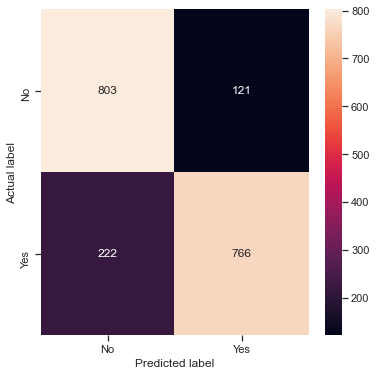

Cross validation result for data 26 is :
0:	learn: 0.6339648	total: 53.5ms	remaining: 10.7s
1:	learn: 0.5928080	total: 108ms	remaining: 10.7s
2:	learn: 0.5678962	total: 156ms	remaining: 10.2s
3:	learn: 0.5428198	total: 216ms	remaining: 10.6s
4:	learn: 0.5256065	total: 269ms	remaining: 10.5s
5:	learn: 0.5086648	total: 332ms	remaining: 10.7s
6:	learn: 0.4986378	total: 380ms	remaining: 10.5s
7:	learn: 0.4894173	total: 431ms	remaining: 10.3s
8:	learn: 0.4816775	total: 497ms	remaining: 10.5s
9:	learn: 0.4756712	total: 550ms	remaining: 10.4s
10:	learn: 0.4710716	total: 598ms	remaining: 10.3s
11:	learn: 0.4678561	total: 668ms	remaining: 10.5s
12:	learn: 0.4643024	total: 715ms	remaining: 10.3s
13:	learn: 0.4616559	total: 784ms	remaining: 10.4s
14:	learn: 0.4594344	total: 871ms	remaining: 10.7s
15:	learn: 0.4579114	total: 922ms	remaining: 10.6s
16:	learn: 0.4556895	total: 972ms	remaining: 10.5s
17:	learn: 0.4540904	total: 1.03s	remaining: 10.4s
18:	learn: 0.4527055	total: 1.07s	remaining: 10.2s

160:	learn: 0.4091947	total: 8.78s	remaining: 2.13s
161:	learn: 0.4090275	total: 8.83s	remaining: 2.07s
162:	learn: 0.4088576	total: 8.88s	remaining: 2.01s
163:	learn: 0.4087679	total: 8.94s	remaining: 1.96s
164:	learn: 0.4086511	total: 8.99s	remaining: 1.91s
165:	learn: 0.4085361	total: 9.04s	remaining: 1.85s
166:	learn: 0.4084257	total: 9.08s	remaining: 1.79s
167:	learn: 0.4082395	total: 9.13s	remaining: 1.74s
168:	learn: 0.4080107	total: 9.18s	remaining: 1.68s
169:	learn: 0.4079419	total: 9.23s	remaining: 1.63s
170:	learn: 0.4078439	total: 9.29s	remaining: 1.57s
171:	learn: 0.4077145	total: 9.36s	remaining: 1.52s
172:	learn: 0.4076174	total: 9.41s	remaining: 1.47s
173:	learn: 0.4075421	total: 9.48s	remaining: 1.42s
174:	learn: 0.4073707	total: 9.53s	remaining: 1.36s
175:	learn: 0.4072019	total: 9.58s	remaining: 1.31s
176:	learn: 0.4071450	total: 9.63s	remaining: 1.25s
177:	learn: 0.4069594	total: 9.69s	remaining: 1.2s
178:	learn: 0.4068890	total: 9.74s	remaining: 1.14s
179:	learn: 0

121:	learn: 0.4117229	total: 6.6s	remaining: 4.22s
122:	learn: 0.4116733	total: 6.64s	remaining: 4.16s
123:	learn: 0.4116457	total: 6.69s	remaining: 4.1s
124:	learn: 0.4112168	total: 6.74s	remaining: 4.04s
125:	learn: 0.4111777	total: 6.79s	remaining: 3.98s
126:	learn: 0.4111055	total: 6.84s	remaining: 3.93s
127:	learn: 0.4107691	total: 6.88s	remaining: 3.87s
128:	learn: 0.4103824	total: 6.93s	remaining: 3.81s
129:	learn: 0.4100413	total: 6.99s	remaining: 3.76s
130:	learn: 0.4100259	total: 7.03s	remaining: 3.7s
131:	learn: 0.4098305	total: 7.08s	remaining: 3.65s
132:	learn: 0.4097987	total: 7.13s	remaining: 3.59s
133:	learn: 0.4096961	total: 7.18s	remaining: 3.54s
134:	learn: 0.4096150	total: 7.23s	remaining: 3.48s
135:	learn: 0.4094322	total: 7.28s	remaining: 3.42s
136:	learn: 0.4092651	total: 7.34s	remaining: 3.38s
137:	learn: 0.4089759	total: 7.39s	remaining: 3.32s
138:	learn: 0.4082431	total: 7.44s	remaining: 3.27s
139:	learn: 0.4081876	total: 7.48s	remaining: 3.21s
140:	learn: 0.4

84:	learn: 0.4212006	total: 4.74s	remaining: 6.41s
85:	learn: 0.4210548	total: 4.81s	remaining: 6.37s
86:	learn: 0.4206609	total: 4.85s	remaining: 6.3s
87:	learn: 0.4203007	total: 4.91s	remaining: 6.25s
88:	learn: 0.4199591	total: 4.96s	remaining: 6.19s
89:	learn: 0.4196665	total: 5.03s	remaining: 6.15s
90:	learn: 0.4194980	total: 5.08s	remaining: 6.09s
91:	learn: 0.4192046	total: 5.13s	remaining: 6.02s
92:	learn: 0.4188253	total: 5.18s	remaining: 5.96s
93:	learn: 0.4187363	total: 5.23s	remaining: 5.9s
94:	learn: 0.4185981	total: 5.31s	remaining: 5.87s
95:	learn: 0.4185193	total: 5.36s	remaining: 5.81s
96:	learn: 0.4180411	total: 5.41s	remaining: 5.75s
97:	learn: 0.4178265	total: 5.46s	remaining: 5.68s
98:	learn: 0.4176705	total: 5.5s	remaining: 5.61s
99:	learn: 0.4174483	total: 5.57s	remaining: 5.57s
100:	learn: 0.4170814	total: 5.61s	remaining: 5.5s
101:	learn: 0.4168872	total: 5.68s	remaining: 5.46s
102:	learn: 0.4167323	total: 5.72s	remaining: 5.39s
103:	learn: 0.4164140	total: 5.7

In [307]:
X_test_all = pd.DataFrame()
y_test_all = pd.DataFrame()
for i in range(splits): 
    data = pd.concat([data1_split[i], data2], ignore_index = True)
    print("\n\n")
    print('Shape of data' + ' ' + str(i) + ' ' +'is :')
    print(data.shape)
    print('Distribution of' + ' ' + str(i) + ' ' + 'is :')
    print(data.TIMELY_RESPONSE.value_counts())
    y = data['TIMELY_RESPONSE']
    X = data.drop(columns = ['TIMELY_RESPONSE', 'CONSUMER_DISPUTED?'])
    X_train, X_test, y_train, y_test = train_test_split(X,y, stratify = y, test_size = 0.07, random_state = i)
    cf = ['PRODUCT', 'SUB_PRODUCT', 'ISSUE', 'COMPANY', 'STATE','SUBMITTED_VIA','COMPANY_RESPONSE_TO_CONSUMER']
    # cf = ['PRODUCT', 'SUBMITTED_VIA','COMPANY_RESPONSE_TO_CONSUMER']
    import catboost as cb
    cat_model = cb.CatBoostClassifier(iterations = 200, random_state = i, cat_features = cf, learning_rate = 0.1)
    cat_model.fit(X_train, y_train,eval_set=(X_test, y_test), use_best_model=True,plot=True, silent = True)
    print('Train f1_score [Yes]: for data' + ' ' + str(i) + ' ' + 'is :', f1_score(y_true = y_train, y_pred = cat_model.predict(X_train), average="binary", pos_label="Yes"))
    print('Train f1_score [No]: for data' + ' ' + str(i) + ' ' + 'is :', f1_score(y_true = y_train, y_pred = cat_model.predict(X_train), average="binary", pos_label="No"))
    y_pred = cat_model.predict(X_test)
    print(classification_report(y_true = y_test, y_pred = y_pred))
    fig = plt.figure(figsize=(6, 6))
    ax= plt.subplot()
    cm = confusion_matrix(y_true=y_test,y_pred=y_pred)
    sns.heatmap(cm, annot=True, ax = ax, fmt = 'g', xticklabels = ['No','Yes'], yticklabels = ['No','Yes'])
    ax.set_xlabel('Predicted label')
    ax.set_ylabel('Actual label')
    plt.show()
    print('Cross validation result for data' + ' ' + str(i) + ' ' + 'is :')
    a,b = cross(cat_model)
    print('Mean train f1-score of data (CV)' + ' ' + str(i) + ' ' + 'is :', a)
    print('Mean test f1-score of data (CV)' + ' ' + str(i) + ' ' + 'is :', b)
    if (X_test_all.shape[0] == 0):
        X_test_all = X_test.copy()
        y_test_all = y_test.copy()
    else:
        X_test_all = pd.concat([X_test_all, X_test], axis = 0)
        y_test_all = pd.concat([y_test_all, y_test], axis = 0)
        
     #Model pickling
    import pickle
    file = open('data' + str(i) + 'model.pkl', 'wb')
    pickle.dump(cat_model,file)   

In [204]:
# y = df1['TIMELY_RESPONSE']
# X = df1.drop(columns = ['TIMELY_RESPONSE', 'CONSUMER_DISPUTED?'])
# X_train, X_test, y_train, y_test = train_test_split(X,y, stratify = y, test_size = 0.1, random_state = 53)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train f1_score [Yes]: 0.986397088077513
Train f1_score [No]: 0.339592130087144
              precision    recall  f1-score   support

          No       1.00      0.19      0.32      3960
         Yes       0.97      1.00      0.99    114226

    accuracy                           0.97    118186
   macro avg       0.99      0.60      0.66    118186
weighted avg       0.97      0.97      0.96    118186



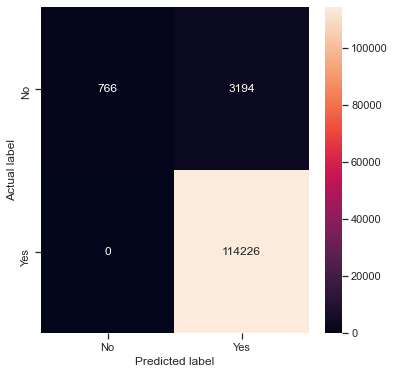

In [197]:
# cf = ['PRODUCT', 'SUB_PRODUCT', 'ISSUE', 'COMPANY', 'STATE','SUBMITTED_VIA','COMPANY_RESPONSE_TO_CONSUMER']
# # cf = ['PRODUCT', 'SUBMITTED_VIA','COMPANY_RESPONSE_TO_CONSUMER']
# import catboost as cb
# cat_model = cb.CatBoostClassifier(iterations = 100, random_state = 3, cat_features = cf, learning_rate = 0.01)
# cat_model.fit(X_train, y_train,
#                               eval_set=(X_test, y_test),
#                               use_best_model=True,
#                               plot=True, silent = True)
# print('Train f1_score [Yes]:', f1_score(y_true = y_train, y_pred = cat_model.predict(X_train), average="binary", pos_label="Yes"))
# print('Train f1_score [No]:', f1_score(y_true = y_train, y_pred = cat_model.predict(X_train), average="binary", pos_label="No"))
# y_pred = cat_model.predict(X_test)
# print(classification_report(y_true = y_test, y_pred = y_pred))
# fig = plt.figure(figsize=(6, 6))
# ax= plt.subplot()
# cm = confusion_matrix(y_true=y_test,y_pred=y_pred)
# sns.heatmap(cm, annot=True, ax = ax, fmt = 'g', xticklabels = ['No','Yes'], yticklabels = ['No','Yes'])
# ax.set_xlabel('Predicted label')
# ax.set_ylabel('Actual label')
# plt.show()

In [157]:
# #Model pickling
# import pickle
# file = open('model.pkl', 'wb')
# pickle.dump(cat_model,file)

In [315]:
X_test_all.shape

(51624, 8)

In [317]:
test_data = pd.concat([X_test_all.reset_index().drop(columns = ['index']), y_test_all.reset_index().drop(columns = ['index'])], axis = 1)

In [320]:
test_data.head(10)

,PRODUCT,SUB_PRODUCT,ISSUE,COMPANY,STATE,SUBMITTED_VIA,COMPANY_RESPONSE_TO_CONSUMER,DATE_DIFF,TIMELY_RESPONSE
0,Debt collection,"Other (i.e. phone, health club, etc.)",Cont'd attempts collect debt not owed,"National Credit Systems,Inc.",TX,Web,Closed with explanation,183.0,No
1,Mortgage,Other mortgage,"Loan modification,collection,foreclosure",Bank of America,CA,Referral,Closed with explanation,1248.0,No
2,Mortgage,Conventional fixed mortgage,"Loan modification,collection,foreclosure",Bank of America,IN,Web,Closed with explanation,1204.0,No
3,Mortgage,Conventional fixed mortgage,"Loan servicing, payments, escrow account",Ditech Financial LLC,KS,Web,Closed with explanation,300.0,Yes
4,Bank account or service,Checking account,Deposits and withdrawals,Wells Fargo & Company,CA,Web,Closed with explanation,167.0,No
5,Debt collection,Credit card,Improper contact or sharing of info,others,NY,Web,Untimely response,110.0,No
6,Debt collection,Payday loan,Disclosure verification of debt,others,OH,Phone,Closed,749.0,No
7,Debt collection,"Other (i.e. phone, health club, etc.)",Cont'd attempts collect debt not owed,Allied Interstate LLC,WA,Referral,Closed with non-monetary relief,61.0,Yes
8,Mortgage,Conventional fixed mortgage,"Loan modification,collection,foreclosure",others,TX,Web,Closed with explanation,1119.0,Yes
9,Debt collection,Medical,Disclosure verification of debt,others,OK,Web,Untimely response,134.0,No


In [323]:
test_data['COMPANY'].nunique()

101